In [83]:
import os
import sys
from pathlib import Path

import anndata as ad
import h5py
import matplotlib.pyplot as plt
import numpy as np

import pandas as pd
import scanpy as sc
import seaborn as sns
from joblib import Parallel, delayed
from matplotlib.pyplot import rc_context
from skimage import exposure, io
from skimage.util import img_as_ubyte
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from tqdm.notebook import tqdm, trange
from matplotlib.patches import Patch

sc.settings.verbosity = 3

In [84]:
import seaborn as sns
from statannotations.Annotator import Annotator

In [85]:
print(sns.__version__)

0.12.2


In [86]:
# # Import spatial omics library
# import athena as ath
# from spatialOmics import SpatialOmics

In [87]:
p_dir = (Path().cwd().parents[0]).absolute()
data_dir = p_dir / "data"

In [88]:
%load_ext autoreload
%autoreload 2

module_path = str(p_dir / "src")

if module_path not in sys.path:
    sys.path.append(module_path)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [89]:
experiment = "Lung"
cores = ['B5', 'C6', 'D4', 'E4', 'E6', 'F4']
datasets = [f'{core}_{i}' for core in cores for i in range(1,5)] + ['F7_3', 'F7_4']


# Load data

In [90]:
import palettable
heatmap_cmp = palettable.cmocean.diverging.Balance_20.mpl_colormap


In [91]:
def read_props(dataset, experiment):
    df_morph = pd.read_csv(data_dir / "props" / f"morphology_IMC_{experiment}_{dataset}.csv")
    df_intensity_IMC = pd.read_csv(data_dir / "props" / f"intensity_IMC_{experiment}_{dataset}.csv")
    df_intensity_TS = pd.read_csv(data_dir / "props" / f"intensity_TS_{experiment}_{dataset}_auto.csv")

    return df_morph, df_intensity_IMC, df_intensity_TS

In [92]:
%%capture 

adatas = []
adatas_raw = []
df_sums = []
for dataset in datasets:
    try:
        df_morph, df_intensity_IMC, df_intensity_TS = read_props(dataset, experiment)
        print(f'Sucessfully read dataset {dataset}') 
    except:
        print(f'{dataset} cannot be read') 
        continue
    try:
        df_intensity_TS.drop(['Rest', 'Total'], axis=1, inplace=True)
    except:
        pass
    df_intensity_TS.iloc[:, 1:] = df_intensity_TS.iloc[:, 1:].multiply(
        df_morph["area"], axis=0
    )
    # data_all = df_intensity_TS.iloc[:, 1:].values
    # data_all_norm = (data_all+0.1)/(np.percentile(data_all,50,axis=1,keepdims=True)+0.1)
    # data_all_norm = MinMaxScaler().fit_transform(data_all)
    # df_intensity_TS.iloc[:, 1:] = data_all_norm
    
    # Merge TS and IMC data
    df = df_intensity_TS
    df.set_index("Id", inplace=True)
    df_sums.append(df.sum(axis=0))
    
    # Put to adata format
    adata = sc.AnnData(df.values)
    adata.var_names = df.columns.tolist()
    adata.obs["Cell"] = df.index.tolist()
    adata.obs["Dataset"] = dataset
    adata.obs["Core"] = dataset.split("_")[0]
    adata.obsm["spatial"] = df_morph[["centroid-0", "centroid-1"]].to_numpy()
    
    # FPM normalize
    sc.pp.normalize_total(adata, target_sum=1e5)
    # sc.pp.log1p(adata, base=2)
    adatas_raw.append(adata.copy())
    
    # Standard scale
    sc.pp.scale(adata)
    adatas.append(adata)
    
adata = ad.concat(adatas, join="inner")
adata_raw = ad.concat(adatas_raw, join="inner")

normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
   

In [93]:
# sc.pl.heatmap(adata, adata.var_names, groupby='Core', swap_axes=False, cmap='bwr', figsize=(20,10), standard_scale='obs', use_raw=False)

In [94]:
# Read Protein clustering info
path = data_dir / "adata" / f"{experiment}.h5ad"
adata_IMC_cluster = ad.read_h5ad(path)


C:\Users\thu71\Anaconda3\envs\scanpy\Lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [95]:
adata_IMC_cluster

AnnData object with n_obs × n_vars = 19507 × 12
    obs: 'Cell', 'Dataset', 'Core', 'leiden', 'Type', 'Region'
    uns: 'Dataset_colors', 'Region_colors', 'Type_colors', 'dendrogram_Type', 'dendrogram_leiden', 'leiden', 'leiden_colors', 'neighbors', 'umap'
    obsm: 'X_scanorama', 'X_umap', 'spatial'
    obsp: 'connectivities', 'distances'

In [96]:
adata = adata[~adata.obs.Dataset.isin(['F7_1', 'F7_2'])]
adata_IMC = adata_IMC_cluster[~adata_IMC_cluster.obs.Dataset.isin(['F7_1', 'F7_2'])]

In [97]:
df_sum = pd.concat(df_sums, axis=1).mean(axis=1)
mz_qc = df_sum[(df_sum > 14000)].index.tolist()
# mz_qc = df_sum[(df_sum > 220)].index.tolist()

In [98]:
len(mz_qc)

177

In [99]:
adata = adata[:, mz_qc]
adata_raw = adata_raw[:, mz_qc]

## Get literature lut

In [100]:
SIMS_masses = adata.var_names

In [101]:
# Read litterature lut
file_path = data_dir / "metadata" / 'Putative_annotation_09012022.xlsx'
df = pd.read_excel(file_path)
lum = df['m/z'].to_numpy()

# get matched table by looking at difference with error
error = 0.4
matched_dfs = []
for mz in SIMS_masses.astype(float):
    if mz < 1.1:
        continue
    diff = lum-mz
    matched = df[abs(diff)<error]
    if len(matched) > 0:
        matched.loc[:,'SIMS mz'] = mz
        matched_dfs.append(matched)
    else:
        matched = pd.DataFrame([['', '', '', '', mz]], columns=df.columns.tolist() + ['SIMS mz'])
        matched_dfs.append(matched)
matched = pd.concat(matched_dfs)

C:\Users\thu71\AppData\Local\Temp\ipykernel_33924\1921335408.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  matched.loc[:,'SIMS mz'] = mz
C:\Users\thu71\AppData\Local\Temp\ipykernel_33924\1921335408.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  matched.loc[:,'SIMS mz'] = mz
C:\Users\thu71\AppData\Local\Temp\ipykernel_33924\1921335408.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the

In [102]:
# Get all info from litterature excel
SIMS_masses_subset = np.array(matched['SIMS mz'].to_list(), dtype=float).astype(str)
SIMS_masses_subset = pd.Index(SIMS_masses_subset)

matched.loc[matched['Molecules'] != '', 'Molecules'] = ' ' + matched.loc[matched['Molecules'] != '', 'Molecules']
SIMS_name_subset = np.array(matched['Molecules'].to_list()).astype(str)
SIMS_name_subset = pd.Index(SIMS_name_subset)
SIMS_name_subset = SIMS_name_subset

SIMS_nm_subset = SIMS_masses_subset + 'm/z' + SIMS_name_subset 

SIMS_type_subset = np.array(matched['Type'].to_list()).astype(str)
SIMS_type_subset = pd.Index(SIMS_type_subset)

print(f"Number of matched m/z: {len(SIMS_masses_subset)}")

Number of matched m/z: 176


In [103]:
adata_all = adata.copy()
adata = adata[:, SIMS_masses_subset]
adata.var_names = SIMS_nm_subset

C:\Users\thu71\Anaconda3\envs\scanpy\Lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [104]:
adata_raw = adata_raw[:, SIMS_masses_subset]
adata_raw.var_names = SIMS_nm_subset


# Tumor vs rest comparison

In [105]:
adata.obs["Region"] = adata_IMC.obs["Region"]
adata.uns["Region_colors"] = adata_IMC.uns["Region_colors"]
adata.obsm["spatial"] = adata_IMC.obsm["spatial"]

         Falling back to preprocessing with `sc.pp.pca` and default params.
computing PCA
    with n_comps=50
    finished (0:00:00)
Storing dendrogram info using `.uns['dendrogram_Region']`
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


C:\Users\thu71\Anaconda3\envs\scanpy\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
C:\Users\thu71\Anaconda3\envs\scanpy\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
C:\Users\thu71\Anaconda3\envs\scanpy\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


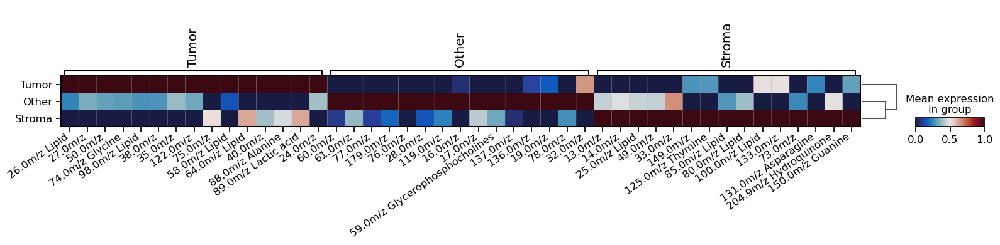

In [106]:
sc.tl.dendrogram(adata, groupby='Region')
sc.tl.rank_genes_groups(adata, groupby='Region', method='t-test_overestim_var', use_raw=False)

with sns.plotting_context('notebook', font_scale=1.2):
    ax = sc.pl.rank_genes_groups_matrixplot(adata, n_genes=15, use_raw=False, cmap=heatmap_cmp, show=False, 
                                           standard_scale='var')
    xticklabels = ax['mainplot_ax'].get_xticklabels()
    ax['mainplot_ax'].set_xticklabels(xticklabels, rotation = 35, ha="right")
    ax['mainplot_ax'].tick_params(axis='x', pad=0)
    plt.show()

In [107]:
# Extract diff expression dataframe
dedf = sc.get.rank_genes_groups_df(adata, group=None)
dedf = dedf[dedf.group != 'Other']

# Get top diff expression
topk=10
masses_largest = dedf.groupby('group').apply(lambda x: x.nlargest(topk,['scores'])).names.unique()
masses_lowest = dedf.groupby('group').apply(lambda x: x.nsmallest(topk,['scores'])).names.unique()
# masses = np.unique(np.concatenate([masses_largest, masses_lowest]))
masses = masses_largest

In [108]:
# Extract dataframe
var = 'Region'

adata_subset = adata[:,masses]
df_SIMS = pd.DataFrame(adata_subset.X, columns=adata_subset.var_names)
df_SIMS[var] = adata_subset.obs[var].tolist()

df_SIMS_grouped = df_SIMS.groupby([var]).mean()

    using data matrix X directly
Storing dendrogram info using `.uns['dendrogram_Region']`


C:\Users\thu71\Anaconda3\envs\scanpy\Lib\site-packages\scanpy\tools\_dendrogram.py:161: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = dat


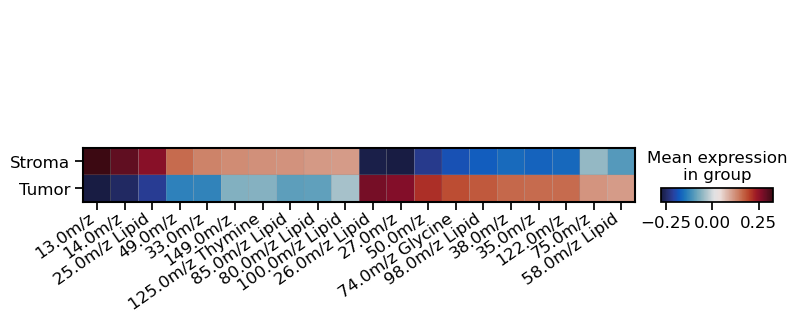

In [109]:
adata_grouped = ad.AnnData(df_SIMS_grouped.values)
adata_grouped.var_names = df_SIMS_grouped.columns.tolist()
adata_grouped.obs[var] = df_SIMS_grouped.index.tolist()
adata_grouped.obs[var] = adata_grouped.obs[var].astype('category')
adata_grouped = adata_grouped[adata_grouped.obs[var] != 'Other']

sc.tl.dendrogram(adata_grouped, groupby=var)
with sns.plotting_context('notebook', font_scale=1.2):
    ax = sc.pl.matrixplot(adata_grouped, var_names=adata_grouped.var_names, 
                     groupby=var, cmap=heatmap_cmp,
                     dendrogram=True, show=False)     
    xticklabels = ax['mainplot_ax'].get_xticklabels()
    ax['mainplot_ax'].set_xticklabels(xticklabels, rotation = 35, ha="right")
    ax['mainplot_ax'].tick_params(axis='x', pad=0)
    plt.show()

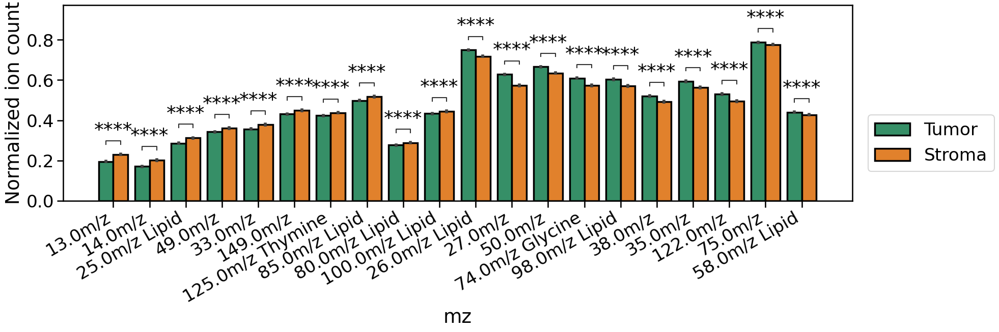

In [110]:
sns.set_context('talk', font_scale=1.5)

# Get subset of masses
adata_subset = adata[:,masses]

# Get dataframe
df_SIMS = pd.DataFrame(adata_subset.X, columns=adata_subset.var_names)
df_SIMS[var] = adata_subset.obs[var].tolist()
df_SIMS = df_SIMS[df_SIMS[var] != 'Other']
df_SIMS.iloc[:,:-1] = MinMaxScaler().fit_transform(df_SIMS.iloc[:,:-1].values)

# Sort masses by GC eexpression
df_SIMS_var = (df_SIMS
                .melt(id_vars=var, var_name='mz', value_name='Normalized ion count'))

# Plot
var = 'Region'
hue_order = ['Tumor', 'Stroma']
palette = adata_subset.uns[f'{var}_colors'][adata_subset.uns[f'dendrogram_{var}']['categories_idx_ordered']]

fig, ax = plt.subplots(figsize=(20,5))
sns.barplot(data=df_SIMS_var, hue=var, x='mz', y='Normalized ion count', linewidth=2.5, edgecolor='k',
            hue_order = hue_order, ax=ax, palette=palette[[0,2]],)
plt.xticks(rotation = 30, ha='right')
plt.legend(bbox_to_anchor=(1.02, 0.15), loc='lower left', borderaxespad=0)

pairs = [((e,'Tumor'),(e,'Stroma')) for e in masses]
annot = Annotator(ax, pairs, data=df_SIMS_var, hue=var, x='mz', y='Normalized ion count', hue_order = hue_order)
annot.configure(test='Mann-Whitney', text_format='star', loc='inside', verbose=0)
annot.apply_test()
ax, test_results = annot.annotate()
# ax.set(ylim=(.2, 1.))

In [111]:
masses

array(['13.0m/z', '14.0m/z', '25.0m/z Lipid', '49.0m/z', '33.0m/z',
       '149.0m/z', '125.0m/z Thymine', '85.0m/z Lipid', '80.0m/z Lipid',
       '100.0m/z Lipid', '26.0m/z Lipid', '27.0m/z', '50.0m/z',
       '74.0m/z Glycine', '98.0m/z Lipid', '38.0m/z', '35.0m/z',
       '122.0m/z', '75.0m/z', '58.0m/z Lipid'], dtype=object)

### Manual selection

In [112]:
glucose_frag = ['71.0m/z', '87.0m/z Pyruvic acid', '99.0m/z Lipid', '119.0m/z', '141.0m/z Lipid', '74.0m/z Glycine',  '89.0m/z Lactic acid', '122.0m/z', ]
# glucose_frag = ['87.0m/z Pyruvic acid', '99.0m/z L-Frag', '74.0m/z Glycine',  '89.0m/z Lactic acid', '122.0m/z', ]

amino_acids = ['74.0m/z Glycine',  '88.0m/z Alanine', '104.0m/z Serine', '114.0m/z Proline', 
               '116.0m/z Valine', '118.0m/z Threonine', '120.0m/z Cysteine', 
               '130.0m/z Isoleucine/leucine', '131.0m/z Asparagine', '132.0m/z Aspartic acid', 
               '145.0m/z Glutamine', '146.0m/z Glutamic acid', '164.0m/z Phenylalanine']

cholesterol_frag = ['95.0m/z Cholesterol fragment', 
                    '109.0m/z Cholesterol fragment', 
                    '147.0m/z Cholesterol fragment',
                    '161.0m/z Cholesterol fragment']

lipids = [e for e in SIMS_nm_subset if 'Lipid' in e]

    using data matrix X directly
Storing dendrogram info using `.uns['dendrogram_Region']`


C:\Users\thu71\Anaconda3\envs\scanpy\Lib\site-packages\scanpy\tools\_dendrogram.py:161: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = dat


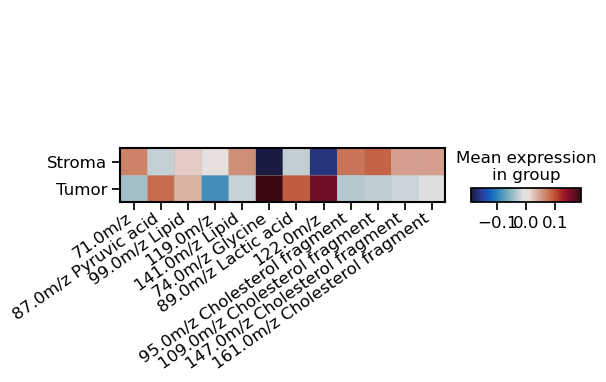

In [113]:
# Plot glucose
adata_subset = adata[:,glucose_frag+cholesterol_frag]
df_SIMS = pd.DataFrame(adata_subset.X, columns=adata_subset.var_names)
df_SIMS[var] = adata_subset.obs[var].tolist()
df_SIMS_grouped = df_SIMS.groupby([var]).mean()

adata_grouped = ad.AnnData(df_SIMS_grouped.values)
adata_grouped.var_names = df_SIMS_grouped.columns.tolist()
adata_grouped.obs[var] = df_SIMS_grouped.index.tolist()
adata_grouped.obs[var] = adata_grouped.obs[var].astype('category')
adata_grouped = adata_grouped[adata_grouped.obs[var] != 'Other']

sc.tl.dendrogram(adata_grouped, groupby=var)
with sns.plotting_context('notebook', font_scale=1.2):
    ax = sc.pl.matrixplot(adata_grouped, var_names=adata_grouped.var_names, 
                     groupby=var, cmap=heatmap_cmp, 
                     dendrogram=True, show=False)     
    xticklabels = ax['mainplot_ax'].get_xticklabels()
    ax['mainplot_ax'].set_xticklabels(xticklabels, rotation = 35, ha="right")
    ax['mainplot_ax'].tick_params(axis='x', pad=0)
    plt.show()

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

87.0m/z Pyruvic acid_Tumor vs. 87.0m/z Pyruvic acid_Stroma: Mann-Whitney-Wilcoxon test two-sided, P_val:1.027e-13 U_stat=3.717e+07
71.0m/z_Tumor vs. 71.0m/z_Stroma: Mann-Whitney-Wilcoxon test two-sided, P_val:1.015e-13 U_stat=3.253e+07
99.0m/z Lipid_Tumor vs. 99.0m/z Lipid_Stroma: Mann-Whitney-Wilcoxon test two-sided, P_val:7.541e-01 U_stat=3.494e+07
119.0m/z_Tumor vs. 119.0m/z_Stroma: Mann-Whitney-Wilcoxon test two-sided, P_val:6.593e-22 U_stat=3.185e+07
141.0m/z Lipid_Tumor vs. 141.0m/z Lipid_Stroma: Mann-Whitney-Wilcoxon test two-sided, P_val:1.001e-07 U_stat=3.319e+07
74.0m/z Glycine_Tumor vs. 74.0m/z Glycine_Stroma: Mann-Whitney-Wilcoxon test two-sided, P_val:5.244e-150 U_stat=4.298e+07
89.0m/z Lactic acid_Tumor vs. 89.0m/z Lactic acid_Stroma: Mann-Whitney-Wilcoxon test two-sided, P_val:1.474e-14 U_stat

[(0.2, 0.8)]

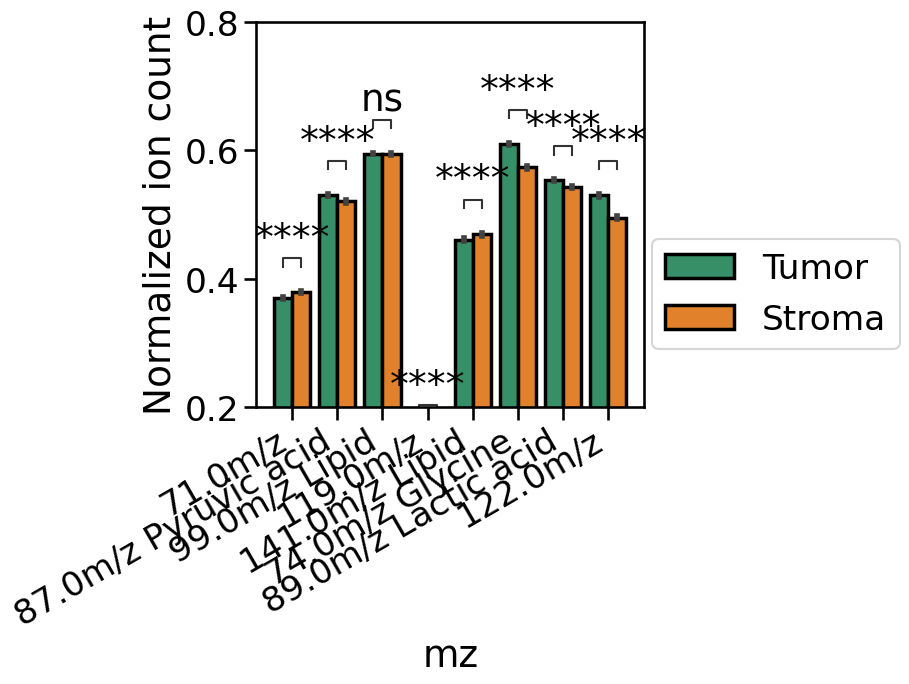

In [114]:
# Get subset of masses
adata_subset = adata[:,glucose_frag]

# Get dataframe
df_SIMS = pd.DataFrame(adata_subset.X, columns=adata_subset.var_names)
df_SIMS[var] = adata_subset.obs[var].tolist()
df_SIMS = df_SIMS[df_SIMS[var] != 'Other']
df_SIMS.iloc[:,:-1] = MinMaxScaler().fit_transform(df_SIMS.iloc[:,:-1].values)

# Sort masses by GC eexpression
df_SIMS_var = (df_SIMS
                .melt(id_vars=var, var_name='mz', value_name='Normalized ion count'))

# Plot
var = 'Region'
hue_order = ['Tumor', 'Stroma']
palette = adata_subset.uns[f'{var}_colors'][adata_subset.uns[f'dendrogram_{var}']['categories_idx_ordered']]

fig, ax = plt.subplots(figsize=(5,5))
sns.barplot(data=df_SIMS_var, hue=var, x='mz', y='Normalized ion count', linewidth=2.5, edgecolor='k',
            hue_order = ['Tumor', 'Stroma'], ax=ax, palette=palette[[0,2]],)
plt.xticks(rotation = 30, ha='right')
plt.legend(bbox_to_anchor=(1.02, 0.15), loc='lower left', borderaxespad=0)

pairs = [((e,'Tumor'),(e,'Stroma')) for e in glucose_frag]
annot = Annotator(ax, pairs, data=df_SIMS_var, hue=var, x='mz', y='Normalized ion count', hue_order = ['Tumor', 'Stroma'])
annot.configure(test='Mann-Whitney', text_format='star', loc='inside', verbose=2)
annot.apply_test()
ax, test_results = annot.annotate()
ax.set(ylim=(.2, .8))

In [115]:
df_SIMS_var.to_clipboard()

    using data matrix X directly
Storing dendrogram info using `.uns['dendrogram_Region']`


C:\Users\thu71\Anaconda3\envs\scanpy\Lib\site-packages\scanpy\tools\_dendrogram.py:161: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = dat


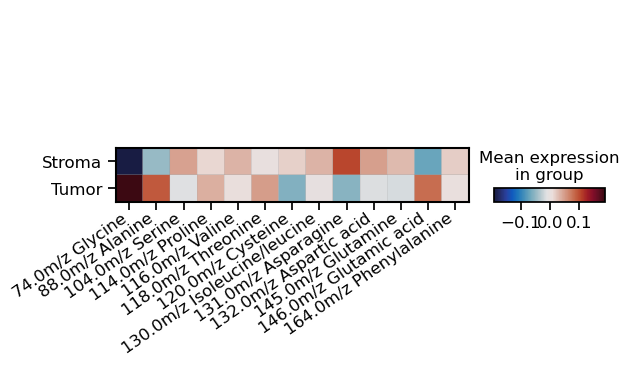

In [116]:
# Plot glucose
adata_subset = adata[:,amino_acids]
df_SIMS = pd.DataFrame(adata_subset.X, columns=adata_subset.var_names)
df_SIMS[var] = adata_subset.obs[var].tolist()
df_SIMS_grouped = df_SIMS.groupby([var]).mean()

adata_grouped = ad.AnnData(df_SIMS_grouped.values)
adata_grouped.var_names = df_SIMS_grouped.columns.tolist()
adata_grouped.obs[var] = df_SIMS_grouped.index.tolist()
adata_grouped.obs[var] = adata_grouped.obs[var].astype('category')
adata_grouped = adata_grouped[adata_grouped.obs[var] != 'Other']

sc.tl.dendrogram(adata_grouped, groupby=var)
with sns.plotting_context('notebook', font_scale=1.2):
    ax = sc.pl.matrixplot(adata_grouped, var_names=adata_grouped.var_names, 
                     groupby=var, cmap=heatmap_cmp,
                     dendrogram=True, show=False)     
    xticklabels = ax['mainplot_ax'].get_xticklabels()
    ax['mainplot_ax'].set_xticklabels(xticklabels, rotation = 35, ha="right")
    ax['mainplot_ax'].tick_params(axis='x', pad=0)
    plt.show()

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

132.0m/z Aspartic acid_Tumor vs. 132.0m/z Aspartic acid_Stroma: Mann-Whitney-Wilcoxon test two-sided, P_val:6.973e-03 U_stat=3.400e+07
145.0m/z Glutamine_Tumor vs. 145.0m/z Glutamine_Stroma: Mann-Whitney-Wilcoxon test two-sided, P_val:1.170e-02 U_stat=3.406e+07
146.0m/z Glutamic acid_Tumor vs. 146.0m/z Glutamic acid_Stroma: Mann-Whitney-Wilcoxon test two-sided, P_val:8.722e-26 U_stat=3.812e+07
164.0m/z Phenylalanine_Tumor vs. 164.0m/z Phenylalanine_Stroma: Mann-Whitney-Wilcoxon test two-sided, P_val:4.259e-01 U_stat=3.460e+07
131.0m/z Asparagine_Tumor vs. 131.0m/z Asparagine_Stroma: Mann-Whitney-Wilcoxon test two-sided, P_val:1.109e-25 U_stat=3.158e+07
88.0m/z Alanine_Tumor vs. 88.0m/z Alanine_Stroma: Mann-Whitney-Wilcoxon test two-sided, P_val:3.757e-18 U_stat=3.756e+07
74.0m/z Glycine_Tumor vs. 74.0m/z Gly

[(0.4, 0.9)]

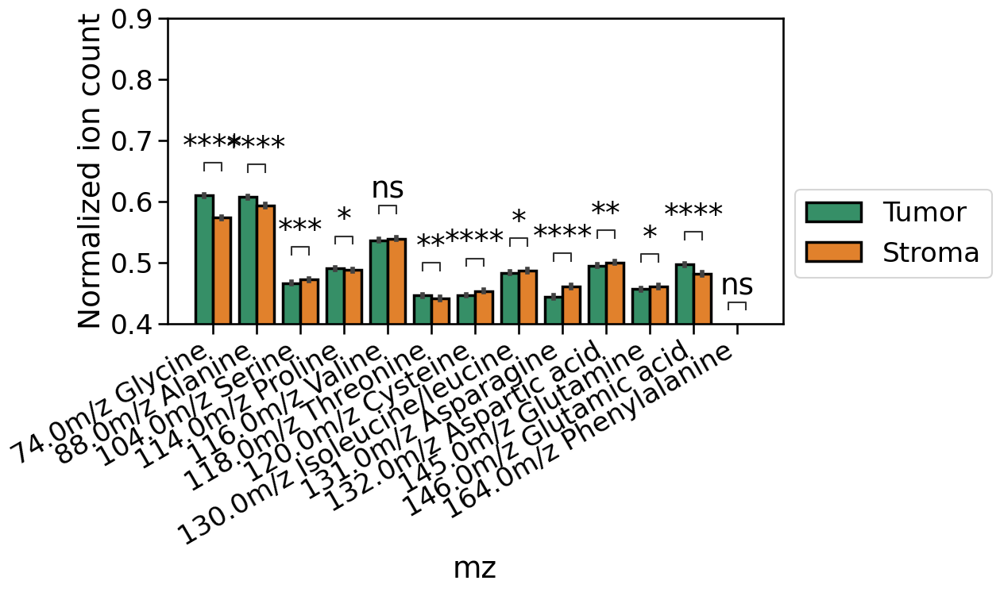

In [117]:
# Get subset of masses
adata_subset = adata[:,amino_acids]

# Get dataframe
df_SIMS = pd.DataFrame(adata_subset.X, columns=adata_subset.var_names)
df_SIMS[var] = adata_subset.obs[var].tolist()
df_SIMS = df_SIMS[df_SIMS[var] != 'Other']
df_SIMS.iloc[:,:-1] = MinMaxScaler().fit_transform(df_SIMS.iloc[:,:-1].values)

# Sort masses by GC eexpression
df_SIMS_var = (df_SIMS
                .melt(id_vars=var, var_name='mz', value_name='Normalized ion count'))

# Plot
var = 'Region'
hue_order = ['Tumor', 'Stroma']
palette = adata_subset.uns[f'{var}_colors'][adata_subset.uns[f'dendrogram_{var}']['categories_idx_ordered']]

fig, ax = plt.subplots(figsize=(10,5))
sns.barplot(data=df_SIMS_var, hue=var, x='mz', y='Normalized ion count', linewidth=2.5, edgecolor='k',
            hue_order = ['Tumor', 'Stroma'], ax=ax, palette=palette[[0,2]],)
plt.xticks(rotation = 30, ha='right')
plt.legend(bbox_to_anchor=(1.02, 0.15), loc='lower left', borderaxespad=0)

pairs = [((e,'Tumor'),(e,'Stroma')) for e in amino_acids]
annot = Annotator(ax, pairs, data=df_SIMS_var, hue=var, x='mz', y='Normalized ion count', hue_order = ['Tumor', 'Stroma'])
annot.configure(test='Mann-Whitney', text_format='star', loc='inside', verbose=2)
annot.apply_test()
ax, test_results = annot.annotate()
ax.set(ylim=(.4, .9))

    using data matrix X directly
Storing dendrogram info using `.uns['dendrogram_Region']`


C:\Users\thu71\Anaconda3\envs\scanpy\Lib\site-packages\scanpy\tools\_dendrogram.py:161: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = dat


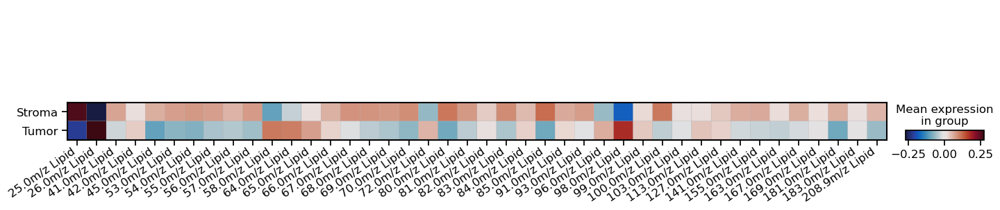

In [118]:
# Plot glucose
adata_subset = adata[:,lipids]
df_SIMS = pd.DataFrame(adata_subset.X, columns=adata_subset.var_names)
df_SIMS[var] = adata_subset.obs[var].tolist()
df_SIMS_grouped = df_SIMS.groupby([var]).mean()

adata_grouped = ad.AnnData(df_SIMS_grouped.values)
adata_grouped.var_names = df_SIMS_grouped.columns.tolist()
adata_grouped.obs[var] = df_SIMS_grouped.index.tolist()
adata_grouped.obs[var] = adata_grouped.obs[var].astype('category')
adata_grouped = adata_grouped[adata_grouped.obs[var] != 'Other']

sc.tl.dendrogram(adata_grouped, groupby=var)
with sns.plotting_context('notebook', font_scale=1.2):
    ax = sc.pl.matrixplot(adata_grouped, var_names=adata_grouped.var_names, 
                     groupby=var, cmap=heatmap_cmp,
                     dendrogram=True, show=False)     
    xticklabels = ax['mainplot_ax'].get_xticklabels()
    ax['mainplot_ax'].set_xticklabels(xticklabels, rotation = 35, ha="right")
    ax['mainplot_ax'].tick_params(axis='x', pad=0)
    plt.show()

[(0.2, 1.0)]

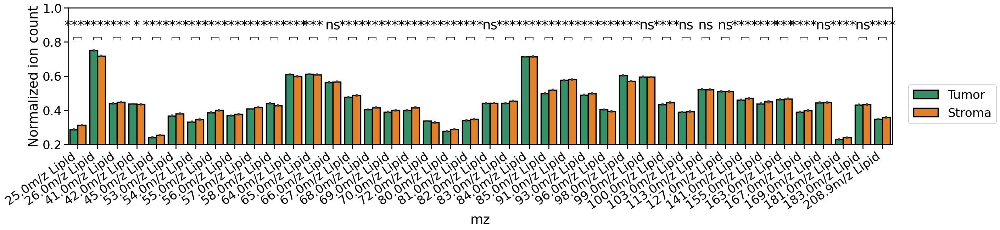

In [119]:
# Get subset of masses
adata_subset = adata[:,lipids]

# Get dataframe
df_SIMS = pd.DataFrame(adata_subset.X, columns=adata_subset.var_names)
df_SIMS[var] = adata_subset.obs[var].tolist()
df_SIMS = df_SIMS[df_SIMS[var] != 'Other']
df_SIMS.iloc[:,:-1] = MinMaxScaler().fit_transform(df_SIMS.iloc[:,:-1].values)

# Sort masses by GC eexpression
df_SIMS_var = (df_SIMS
                .melt(id_vars=var, var_name='mz', value_name='Normalized ion count'))

# Plot
var = 'Region'
hue_order = ['Tumor', 'Stroma']
palette = adata_subset.uns[f'{var}_colors'][adata_subset.uns[f'dendrogram_{var}']['categories_idx_ordered']]

fig, ax = plt.subplots(figsize=(30,5))
sns.barplot(data=df_SIMS_var, hue=var, x='mz', y='Normalized ion count', linewidth=2.5, edgecolor='k',
            hue_order = ['Tumor', 'Stroma'], ax=ax, palette=palette[[0,2]],)
plt.xticks(rotation = 35, ha='right')
plt.legend(bbox_to_anchor=(1.02, 0.15), loc='lower left', borderaxespad=0)

pairs = [((e,'Tumor'),(e,'Stroma')) for e in lipids]
annot = Annotator(ax, pairs, data=df_SIMS_var, hue=var, x='mz', y='Normalized ion count', hue_order = ['Tumor', 'Stroma'])
annot.configure(test='Mann-Whitney', text_format='star', loc='outside', verbose=0, text_offset=10, line_offset=10)
annot.apply_test()
ax, test_results = annot.annotate()
ax.set(ylim=(.2, 1.))

### Plot by mz channel

In [120]:
import palettable
h5_data_dir = p_dir / "data" / "h5"
heatmap_cmp = palettable.cmocean.diverging.Balance_20.mpl_colormap

from typing import List
import matplotlib
import skimage
from skimage import measure

h5_data_dir = p_dir / "data" / "h5"

# Read mask image
def get_masks(mask_folder):
    """
    Function to get all mask from mask forlder
    """
    # Read masks
    masks = {}

    for (dirpath, dirnames, filenames) in os.walk(mask_folder):
        for name in sorted(filenames):
            if "tif" in name:
                filename = os.path.join(dirpath, name)
                img = skimage.io.imread(filename)
                condition = name.split(".")[0]
                masks[condition] = img
            else:
                continue
    return masks


def create_clustered_cell(mask, cell2count,  **kwargs):
    img = np.zeros((mask.shape[0], mask.shape[1]))*np.nan

    for cell, counts in cell2count.items():
        rows, cols = np.where(np.isin(mask, cell))
        img[rows, cols] = counts

    return img

def get_contour(mask: np.ndarray) -> List[List[float]]:
    """
    Get contours of mask
    """
    contours = []
    for i in sorted(np.unique(mask)):
        if i == 0:
            continue
        contours.append(measure.find_contours(mask == i, 0.8)[0])

    return contours

def get_imgs_sims(experiment, name):
    with h5py.File(h5_data_dir / f"{experiment}.hdf5", "r") as f:
        imgs = f[name][:]
        labels = list(f[name].attrs["labels"])
    return imgs[2:], labels[2:]

def IMS(imgs, mz, masses):
    mz_img = imgs[np.equal(masses, mz),...][0]
    fig, ax = plt.subplots(figsize=(10,10))
    ax.imshow(mz_img, cmap='rainbow', interpolation='quadric', vmin=0, vmax=np.percentile(mz_img, 90))  
    ax.axis('off')
    plt.title(f'{mz} m/z')
    plt.show()
    return mz_img 

def IMS(imgs, mz, masses):
    mz_img = imgs[np.equal(masses, mz),...][0]
    # fig, ax = plt.subplots(figsize=(7,7))
    # ax.imshow(mz_img, cmap=heatmap_cmp, interpolation='quadric', vmin=0,vmax=np.percentile(mz_img, 99))  
    # ax.axis('off')
    # plt.title(f'{mz} m/z')
    # plt.show()
    return mz_img 

In [121]:
masks = get_masks(data_dir / "masks")
experiment='Lung'

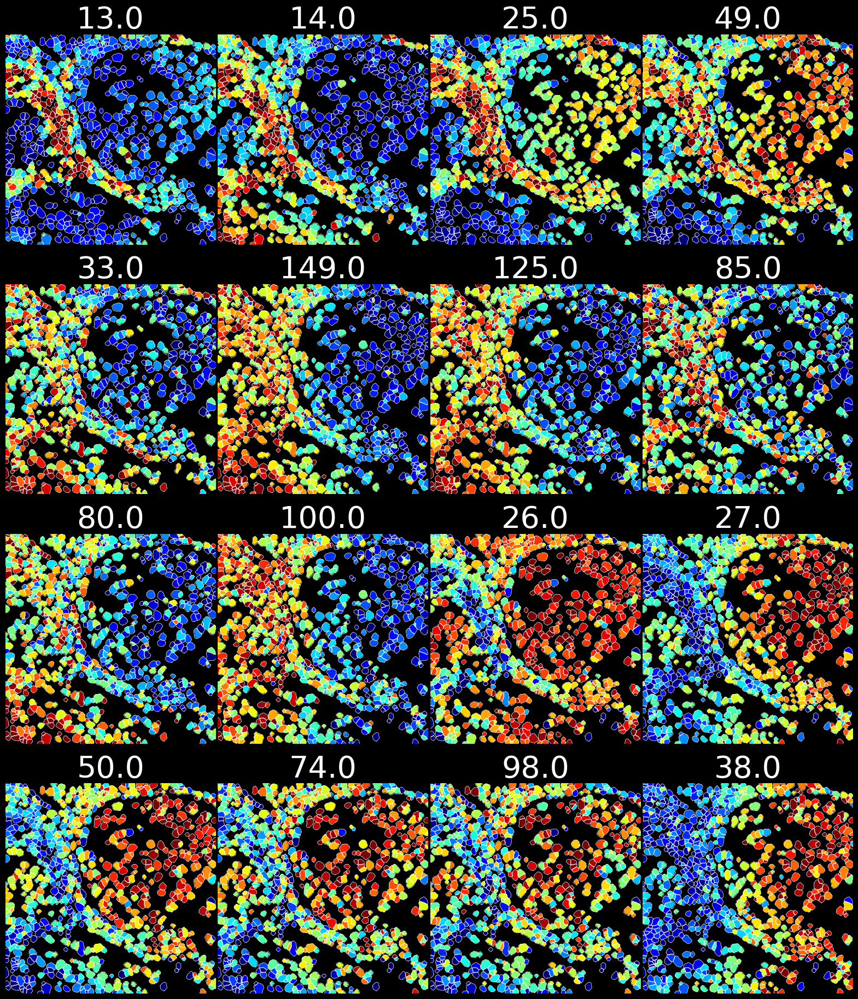

In [122]:
dataset = 'B5_1'

mask = masks[experiment + '_' + dataset]
contours = get_contour(mask)

adata_fov = adata[adata.obs['Dataset'] == dataset]

fig, axs = plt.subplots(4,4,figsize=(20, 23), facecolor='k')
axs = axs.flatten()
for i, channel in enumerate(masses[:16]):
    ax = axs[i]
    
    adata_subset = adata_fov[:, channel]
    # Get label2cell dict
    cells = adata_subset.obs['Cell'].to_list()
    counts = adata_subset.X.flatten()
    cell2count = dict(zip(cells, counts))

    img = create_clustered_cell(mask, cell2count)

    ax.imshow(img, cmap='jet', vmin=np.nanpercentile(img, 5), vmax=np.nanpercentile(img, 95))
    ax.set_title(f"{channel.split('m/z')[0]}", size=40, c='w')
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color="white")
    ax.axis("off")
fig.subplots_adjust(wspace=0.01, hspace=0.14)
plt.show()

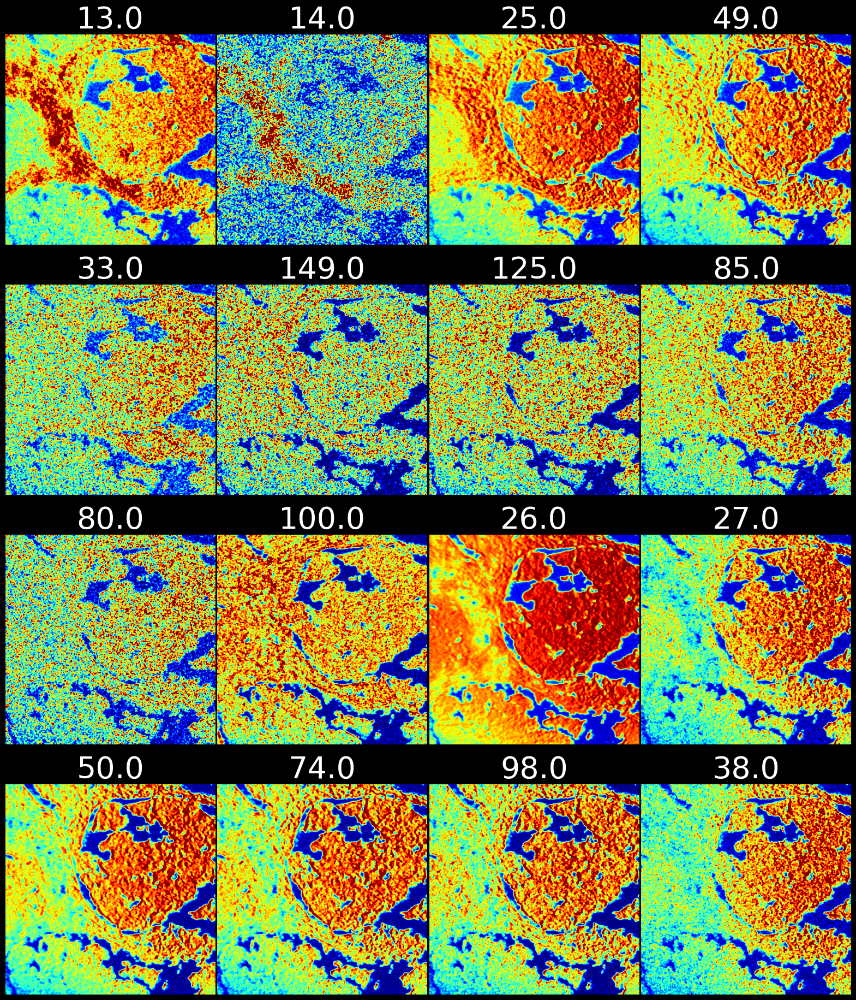

In [123]:
imgs, labels = get_imgs_sims(experiment, 'auto_'+dataset)
mzs = np.array(df_intensity_TS.columns.tolist()).astype(float)

fig, axs = plt.subplots(4,4,figsize=(20, 23), facecolor='k')
axs = axs.flatten()
for i, channel in enumerate(masses[:16]):
    ax = axs[i]
    ax.axis("off")
    mz = float(channel.split('m/z')[0])
    mz_img = IMS(imgs, mz, mzs)
    mz_img = skimage.transform.resize(mz_img, mask.shape, anti_aliasing=True, anti_aliasing_sigma=1)
    
    ax.imshow(mz_img, cmap='jet', interpolation=None, vmin=0, vmax=np.percentile(mz_img, 95))
    ax.set_title(mz, size=40, c='w')
    ax.axis("off")
fig.subplots_adjust(wspace=0.01, hspace=0.15)
plt.show()


### Plot one mz for couple of ROI

In [134]:
def create_clustered_cell(mask, cell2count,  **kwargs):
    img = np.zeros((mask.shape[0], mask.shape[1]))*np.nan

    for cell, counts in cell2count.items():
        rows, cols = np.where(np.isin(mask, cell))
        img[rows, cols] = counts

    return img

In [135]:
datasets_subset = ['B5_1',
 'B5_3',
 # 'C6_2',
 'C6_4',
 # 'D4_1',                  
 'D4_2',
 'E4_3',
 'E6_1',
 'F4_2',
 'F7_3'
]

In [136]:
masses

array(['13.0m/z', '14.0m/z', '25.0m/z Lipid', '49.0m/z', '33.0m/z',
       '149.0m/z', '125.0m/z Thymine', '85.0m/z Lipid', '80.0m/z Lipid',
       '100.0m/z Lipid', '26.0m/z Lipid', '27.0m/z', '50.0m/z',
       '74.0m/z Glycine', '98.0m/z Lipid', '38.0m/z', '35.0m/z',
       '122.0m/z', '75.0m/z', '58.0m/z Lipid'], dtype=object)

Exception ignored in: <function tqdm.__del__ at 0x000001AE0D53D580>
Traceback (most recent call last):
  File "C:\Users\thu71\Anaconda3\envs\scanpy\Lib\site-packages\tqdm\std.py", line 1145, in __del__
    self.close()
  File "C:\Users\thu71\Anaconda3\envs\scanpy\Lib\site-packages\tqdm\notebook.py", line 283, in close
    self.disp(bar_style='danger', check_delay=False)
    ^^^^^^^^^
AttributeError: 'tqdm_notebook' object has no attribute 'disp'


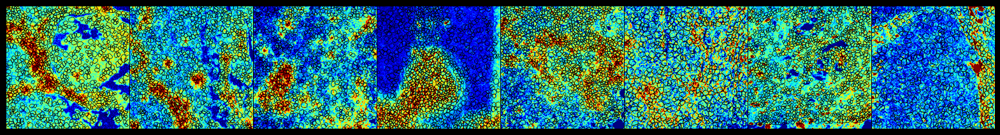

In [137]:
fig, axs = plt.subplots(1,8,figsize=(20,5), facecolor='k')
axs = axs.flatten()
channel = '13.0m/z'

for i, dataset in enumerate(datasets_subset):
    mask = masks[experiment + '_' + dataset]
    contours = get_contour(mask)

    imgs, labels = get_imgs_sims(experiment, 'auto_'+dataset)
    mzs = np.array(df_intensity_TS.columns.tolist()).astype(float)
    imgs_stack = skimage.transform.resize(imgs, (imgs.shape[0], mask.shape[0], mask.shape[0]), order=2, preserve_range=True, anti_aliasing=False)
    mean = np.mean(imgs_stack, axis=0, keepdims=False)+1
    
    ax = axs[i]
    ax.axis("off")
    mz = float(channel.split('m/z')[0])
    mz_img = IMS(imgs, mz, mzs)
    mz_img = skimage.transform.resize(mz_img, mask.shape, anti_aliasing=True, anti_aliasing_sigma=1)
    mz_img = mz_img/mean 
    
    ax.imshow(mz_img, cmap='jet', interpolation=None, vmin=np.percentile(mz_img, 2), vmax=np.percentile(mz_img, 98))
    ax.axis("off")
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color="k")
    ax.axis("off")

fig.subplots_adjust(wspace=0.01)

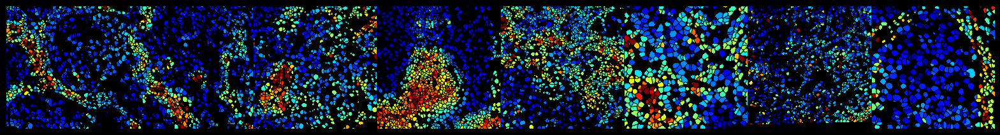

In [138]:
fig, axs = plt.subplots(1,8,figsize=(20,5), facecolor='k')
axs = axs.flatten()

for i, dataset in enumerate(datasets_subset):
    mask = masks[experiment + '_' + dataset]
    contours = get_contour(mask)

    adata_subset = adata[adata.obs['Dataset'] == dataset, channel]
    
    # Get label2cell dict
    cells = adata_subset.obs['Cell'].to_list()
    counts = adata_subset.X.flatten()
    cell2count = dict(zip(cells, counts))

    img = create_clustered_cell(mask, cell2count)
    
    ax = axs[i]
    ax.axis("off")

    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ax.set_facecolor('darkblue')
    ax.imshow(img, cmap='jet', vmin=np.nanpercentile(img, 2), vmax=np.nanpercentile(img, 98))
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color="k")

fig.subplots_adjust(wspace=0.01)

In [139]:
# from matplotlib.colors import LinearSegmentedColormap

# my_cmap = LinearSegmentedColormap.from_list('my_gradient', (
#     # Edit this gradient at https://eltos.github.io/gradient/#0:000C41-21:0046FF-28:29FF0C-44.5:A6FF00-52.3:F9FF00-57.9:FF0D1A-76:FF002A-88.1:FF7BF3-100:FFFFFF
#     (0.000, (0.000, 0.047, 0.255)),
#     (0.210, (0.000, 0.275, 1.000)),
#     (0.280, (0.161, 1.000, 0.047)),
#     (0.445, (0.651, 1.000, 0.000)),
#     (0.523, (0.976, 1.000, 0.000)),
#     (0.579, (1.000, 0.051, 0.102)),
#     (0.760, (1.000, 0.000, 0.165)),
#     (0.881, (1.000, 0.482, 0.953)),
#     (1.000, (1.000, 1.000, 1.000))))


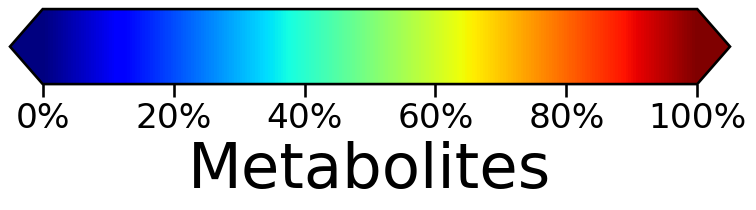

In [140]:
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.ticker import PercentFormatter

plt.rcParams.update({'font.size':20})

# Make a figure and axes with dimensions as desired.
fig = plt.figure(figsize=(8, 5))
ax1 = fig.add_axes([0.05, 0.80, 0.9, 0.15])

norm = mpl.colors.Normalize(vmin=0., vmax=1)

# Fist Cell type
cb1 = mpl.colorbar.ColorbarBase(ax1, cmap='jet',
                                norm=norm, extend='both',
                                orientation='horizontal')
cb1.set_label(f'Metabolites', fontsize=45)
cb1.ax.xaxis.set_major_formatter(PercentFormatter(1, 0))


# Tumor density

In [141]:
for dataset in adata.obs.Dataset.unique():
    adata_subset = adata[adata.obs.Dataset == dataset]
    centroids = adata_subset.obsm['spatial']
    
    break

In [142]:
centroids_tumor = adata_subset[adata_subset.obs.Region == 'Tumor'].obsm['spatial']

In [143]:
# fig, ax = plt.subplots(figsize=(7,7))
# sns.kdeplot(x=centroids_tumor[:,1], y=centroids_tumor[:,0], cmap="Reds", shade=True, bw_adjust=.5, ax=ax)
# ax.invert_yaxis()

# CD31 Analysis

In [144]:
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
import palettable
heatmap_cmp = palettable.cmocean.diverging.Balance_20.mpl_colormap

def get_distance(adata, adata_ref, n=1):
    data_ref = adata_ref.obsm["spatial"]
    data = adata.obsm["spatial"]
    fit = NearestNeighbors(n_neighbors=n ).fit(data_ref)
    m = fit.kneighbors(data)
    m = m[0], m[1] # Distances, Indices

    return m[0]


## Get distance to CD31 positif cells

In [145]:
# sns.displot(pd.DataFrame(adata_IMC[:, 'CD31'].X), kind="kde")

In [146]:
distances = []
adatas = []
adatas_SIMS = []
scaler = MinMaxScaler()

for dataset in adata_IMC.obs['Dataset'].unique():
    adata_fov = adata_IMC[adata_IMC.obs['Dataset'] == dataset]
    adata_fov_sims = adata[adata.obs['Dataset'] == dataset]
    try:
        mask = masks["_".join([experiment, dataset])]
        contours = get_contour(mask)
    except:
        print(dataset)
        continue
    
    adata_ref = adata_fov[adata_fov[:,'CD31'].X > 0.05]
    if len(adata_ref) < 10:
        continue
    
    
    d = get_distance(adata_fov, adata_ref)
    d = scaler.fit_transform(d)
    d = d.flatten()
    
    distances.append(d)
    adatas.append(adata_fov)
    adatas_SIMS.append(adata_fov_sims)

In [147]:
distance = np.concatenate(distances)
adata_distance = ad.concat(adatas_SIMS)

df = pd.DataFrame(adata_distance.X, columns=adata_distance.var_names.tolist())
df['Proximity to CD31'] = distance
df_corr = df.corr()


C:\Users\thu71\Anaconda3\envs\scanpy\Lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [148]:
df

,12.0m/z,13.0m/z,14.0m/z,16.0m/z,17.0m/z,19.0m/z,22.6m/z,24.0m/z,25.0m/z Lipid,26.0m/z Lipid,...,200.9m/z,204.9m/z Hydroquinone,208.9m/z Lipid,210.0m/z,216.9m/z,228.9m/z,233.9m/z,242.9m/z,253.3m/z FA(16:1),Proximity to CD31
0,0.591617,2.158170,0.316844,-0.645163,-0.610623,0.596484,0.609588,0.260585,0.735184,-1.290387,...,-0.846569,1.506726,0.371275,2.632902,0.070665,0.411397,1.791926,1.295908,2.743247,0.000000
1,-1.067873,0.185718,0.426489,-0.446662,-0.512566,0.521844,0.194260,-0.460121,0.172410,-0.842890,...,2.303790,1.208954,0.307369,0.569318,1.482185,0.620330,1.526231,0.782797,1.754728,0.000000
2,-0.532839,-0.039789,0.685198,-0.498451,-0.491599,-0.038949,0.166144,-0.301324,0.077582,-0.108245,...,-0.763384,0.381897,0.892743,0.167096,0.744170,-0.392500,-0.322025,0.146462,-0.386298,0.000000
3,-0.354443,-0.823071,-0.151477,-0.335769,-0.459937,0.402163,-0.016605,-0.653614,-0.973069,0.314973,...,0.096928,0.093625,-0.088945,0.129564,-0.273037,-0.045557,1.354321,0.921435,1.127724,0.329174
4,-0.180182,-0.309183,-0.405259,-0.143090,-0.516805,-0.161169,-0.127322,0.125451,-0.916094,0.634422,...,-1.574918,0.677589,-0.182908,0.192552,0.117755,-0.242612,-0.131849,-0.176902,0.028828,0.264904
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16004,-0.610455,0.260088,0.523141,-0.543080,-0.607270,-1.442857,0.042133,-0.763679,-0.142765,1.117726,...,-0.512298,1.417596,-0.605949,1.847158,-0.687063,-0.744589,0.975045,0.900412,-0.147137,0.445807
16005,0.546698,-0.512693,-0.762214,-0.606261,-0.934839,-1.592868,-0.639825,0.305376,0.008734,1.825702,...,0.602320,0.365104,-2.098437,-1.405412,0.291168,-1.873836,-0.102963,0.577433,0.591189,0.992527
16006,0.023723,-0.756669,-0.971044,-0.539520,-0.611391,0.015183,1.429060,-0.575228,-1.178643,1.548049,...,0.801289,-0.316295,0.234331,0.270416,-0.931237,-1.929440,0.734355,1.073432,0.488414,0.974909
16007,-0.697996,-0.703809,-0.870840,-0.563071,-0.552008,-1.517274,-1.240200,-0.994567,-1.033759,0.929947,...,-0.412292,-0.559108,-0.229716,-0.623669,0.899374,1.005290,0.982635,0.163970,-0.992843,0.894173


## Plot metabolites to distance correlation

In [149]:
n = 8
marker = 'Proximity to CD31'
n_cut = 25

# Get positive and negative correlation
corr_pos = df_corr.loc[marker].nlargest(25).index.tolist()
corr_neg = df_corr.loc[marker].nsmallest(25).index.tolist()

# Get only SIMS masses
corr_pos = [corr for corr in corr_pos if corr in SIMS_nm_subset][:n]
corr_neg = [corr for corr in corr_neg if corr in SIMS_nm_subset][:n]
corr_list = [marker] + corr_pos + corr_neg

# Get range 
df_intensity = df[corr_list]
df_intensity.sort_values(by=[marker], inplace=True)
df_intensity[f'{marker} cut'] = pd.qcut(df_intensity[marker], n_cut, duplicates='drop') 

LE = LabelEncoder()
df_intensity[f'{marker} cut'] = LE.fit_transform(df_intensity[f'{marker} cut'])

C:\Users\thu71\AppData\Local\Temp\ipykernel_33924\1028058216.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_intensity.sort_values(by=[marker], inplace=True)
C:\Users\thu71\AppData\Local\Temp\ipykernel_33924\1028058216.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_intensity[f'{marker} cut'] = pd.qcut(df_intensity[marker], n_cut, duplicates='drop')
C:\Users\thu71\AppData\Local\Temp\ipykernel_33924\1028058216.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] =

In [150]:
df_sort = df_intensity.groupby('Proximity to CD31 cut').median()

adata_cd31_corr = sc.AnnData(df_sort.iloc[:,1:])
adata_cd31_corr.var_names = df_sort.iloc[:,1:].columns.tolist()
# adata_cd31_corr.obs['Proximity'] = df_sort.iloc[:,1].values
adata_cd31_corr.obs['Proximity'] = df_sort.index.tolist()

C:\Users\thu71\Anaconda3\envs\scanpy\Lib\site-packages\anndata\_core\anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


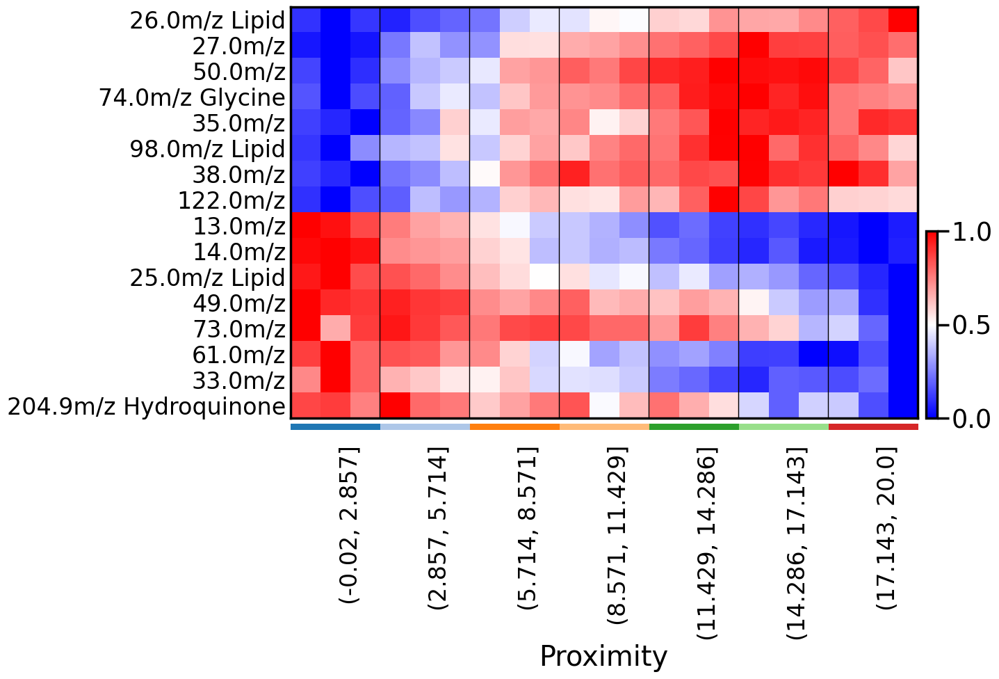

In [151]:
with sns.plotting_context('poster', font_scale=1.2):
    sc.pl.heatmap(adata_cd31_corr, adata_cd31_corr.var_names, groupby='Proximity', swap_axes=True, cmap='bwr', figsize=(12,8), standard_scale='var')

## Additional plot 

In [152]:
from scipy import stats
import sklearn.metrics


In [153]:
df_sort.head()

,Proximity to CD31,26.0m/z Lipid,27.0m/z,50.0m/z,74.0m/z Glycine,35.0m/z,98.0m/z Lipid,38.0m/z,122.0m/z,13.0m/z,14.0m/z,25.0m/z Lipid,49.0m/z,73.0m/z,61.0m/z,33.0m/z,204.9m/z Hydroquinone
Proximity to CD31 cut,,,,,,,,,,,,,,,,,
0,0.000000,-0.210528,-0.289695,-0.186087,-0.170644,-0.161254,-0.218966,-0.205719,-0.230319,0.171904,0.135998,0.148985,0.099683,0.093200,-0.092035,0.051881,0.016570
1,0.067720,-0.312629,-0.322952,-0.271870,-0.270090,-0.186819,-0.285761,-0.228815,-0.294161,0.149789,0.146636,0.182905,0.056821,-0.060975,-0.052638,0.165412,0.024901
2,0.082733,-0.202913,-0.290848,-0.211947,-0.181736,-0.223825,-0.116350,-0.269116,-0.192880,0.071070,0.122020,0.076200,0.041617,0.038646,-0.115559,0.081638,-0.027773
3,0.099615,-0.243362,-0.142430,-0.095334,-0.155513,-0.126585,-0.067816,-0.154596,-0.171516,0.001615,-0.027271,0.068851,0.065313,0.073279,-0.104373,0.016529,0.071171
4,0.117225,-0.156442,-0.035260,-0.043993,-0.036709,-0.092640,-0.052454,-0.132944,-0.047646,-0.052107,-0.040524,0.036112,0.041809,0.039670,-0.109337,-0.001528,-0.010786


Text(0.02, 0.5, 'Metabolite')

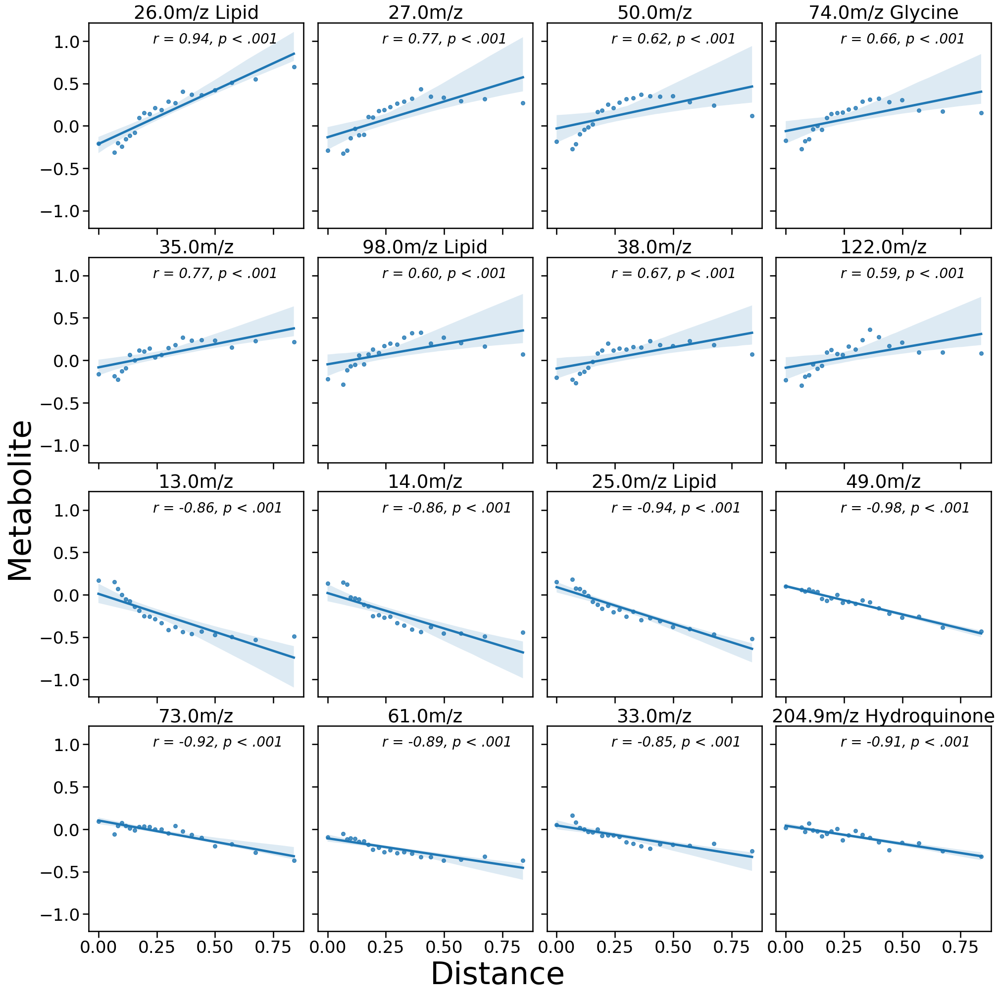

In [154]:
df_corr = df_sort

fig, axs = plt.subplots(4,4, figsize=(20,20), sharex=True, sharey=True, constrained_layout=True)
distance = df_corr .iloc[:, 0].tolist()
name = df_corr.columns.tolist()

axs = axs.flatten()
for i, ax in enumerate(axs):
    channel = df_corr .columns[1+i]
    r_score,  p_value = stats.pearsonr(distance, df_corr [channel].tolist())

    reg = sns.regplot(x=distance, y=df_corr [channel].tolist(), ax=ax, scatter_kws={'s': 30})
    # reg.set(xlabel='Distance', ylabel='')
    reg.text(0.3, 0.9, f'r = {r_score:.2f}, p < .001', fontstyle='italic', transform=ax.transAxes)
    ax.set_title(name[1+i])
fig.supxlabel('Distance',fontsize=45)
fig.supylabel('Metabolite', fontsize=45)


In [155]:
df_corr.to_clipboard()

## Plot example

In [63]:
# Plotting
def create_intensity_cell(mask, cell2intensity, **kwargs):
    img = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.float)*np.nan

    for cell, intensity in tqdm(cell2intensity.items(), total=len(cell2intensity)):
        rows, cols = np.where(np.isin(mask, cell))
        img[rows, cols] = intensity
    return img


  0%|          | 0/937 [00:00<?, ?it/s]

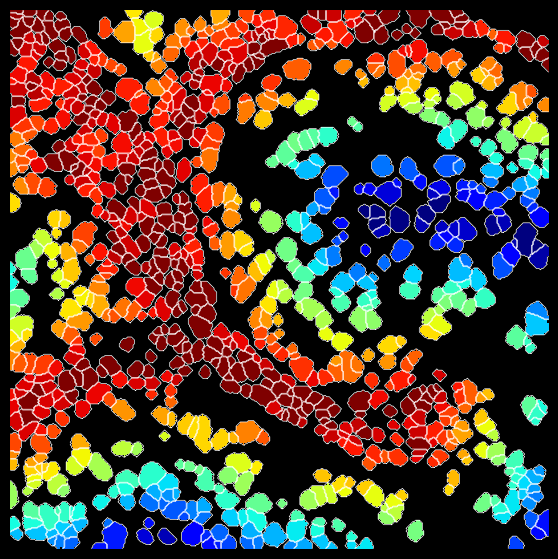

  0%|          | 0/960 [00:00<?, ?it/s]

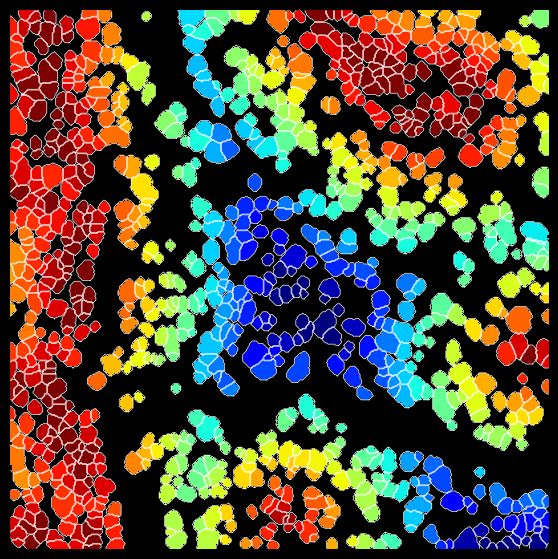

  0%|          | 0/993 [00:00<?, ?it/s]

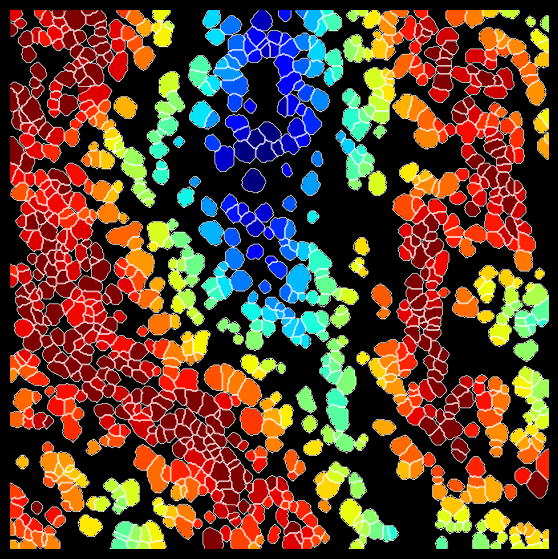

  0%|          | 0/905 [00:00<?, ?it/s]

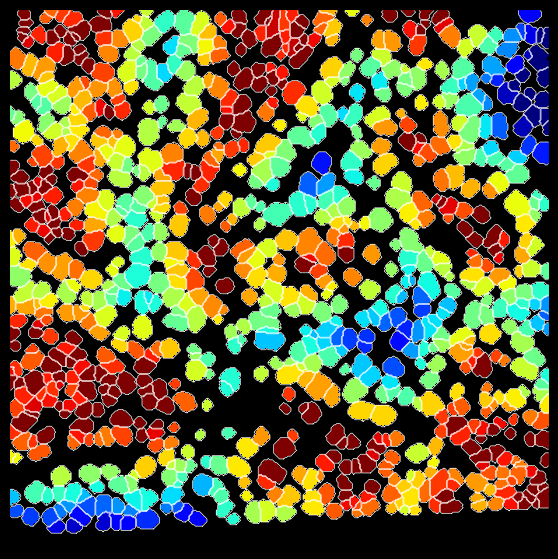

  0%|          | 0/970 [00:00<?, ?it/s]

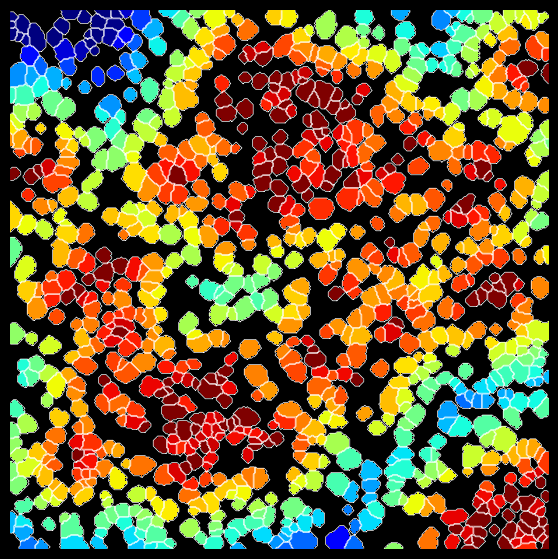

  0%|          | 0/1282 [00:00<?, ?it/s]

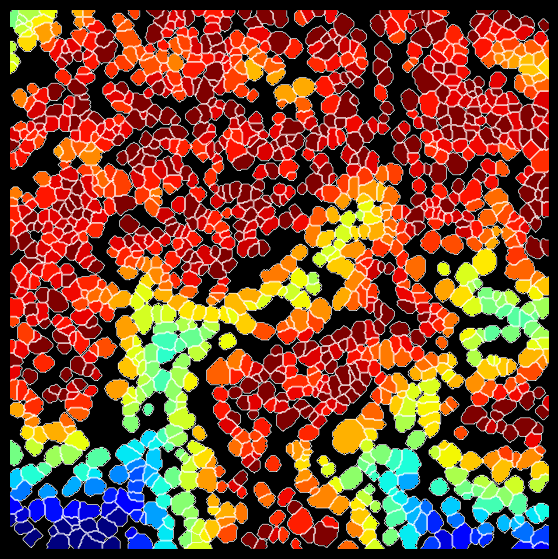

  0%|          | 0/866 [00:00<?, ?it/s]

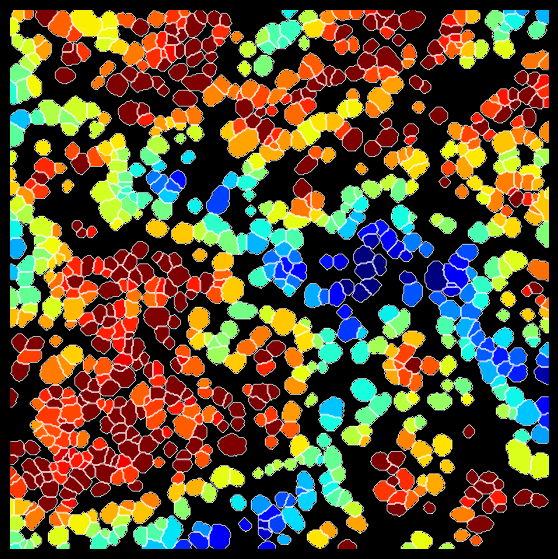

  0%|          | 0/948 [00:00<?, ?it/s]

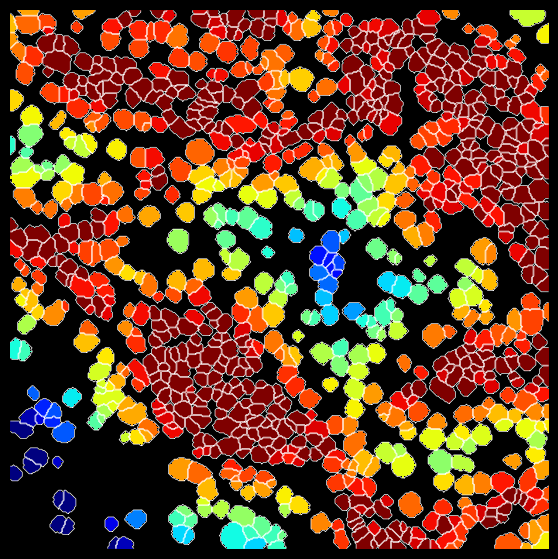

  0%|          | 0/1117 [00:00<?, ?it/s]

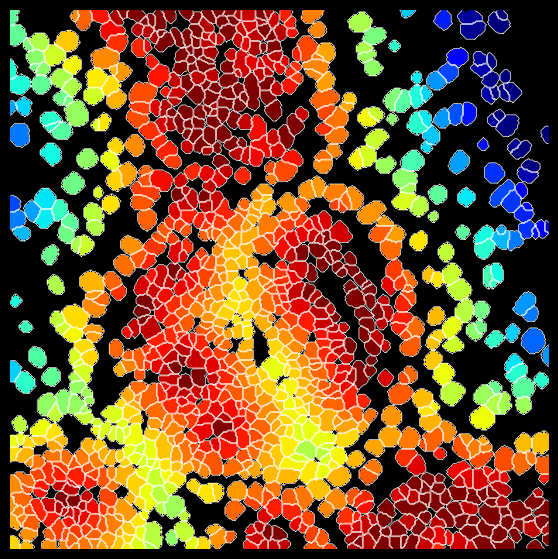

  0%|          | 0/931 [00:00<?, ?it/s]

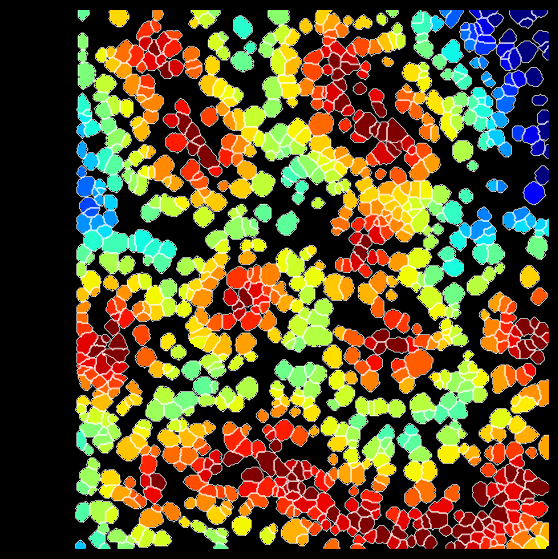

  0%|          | 0/1293 [00:00<?, ?it/s]

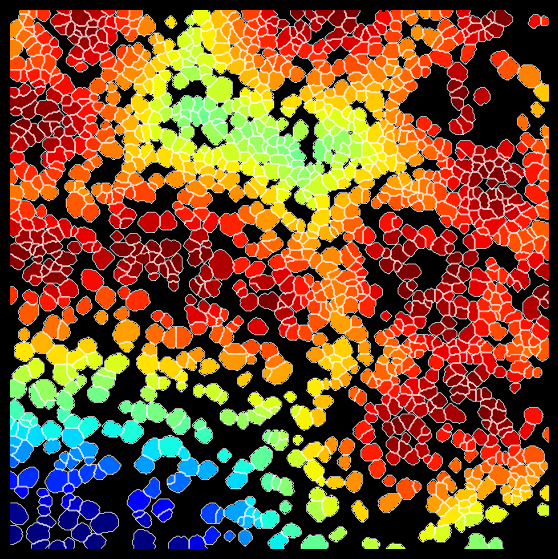

  0%|          | 0/533 [00:00<?, ?it/s]

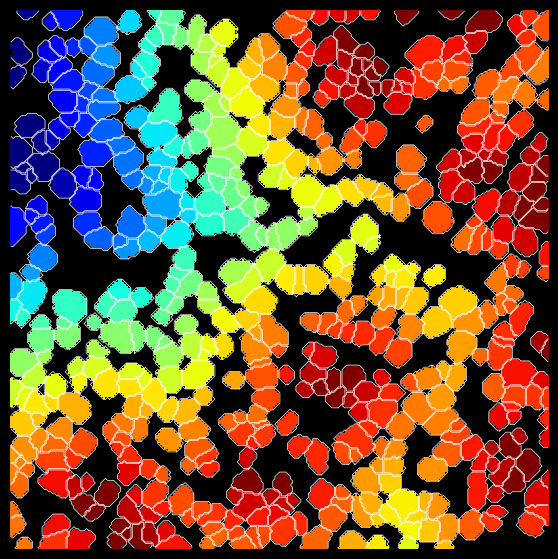

  0%|          | 0/415 [00:00<?, ?it/s]

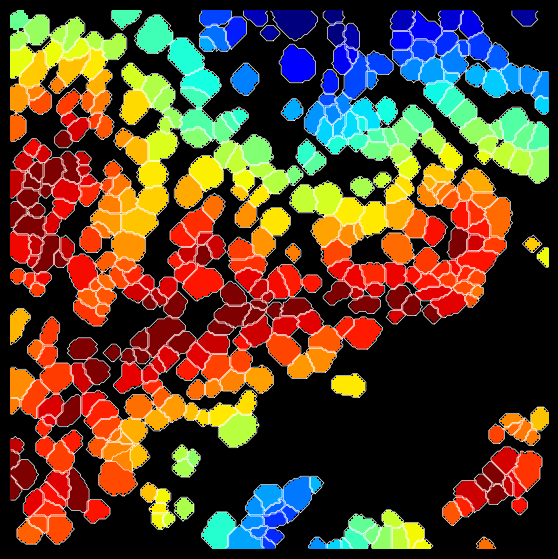

  0%|          | 0/474 [00:00<?, ?it/s]

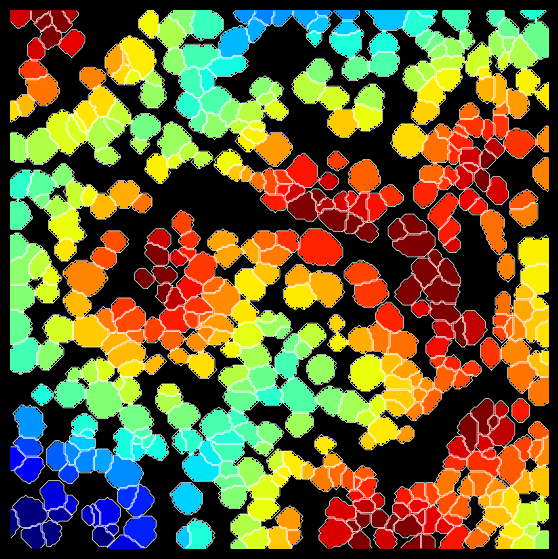

  0%|          | 0/1072 [00:00<?, ?it/s]

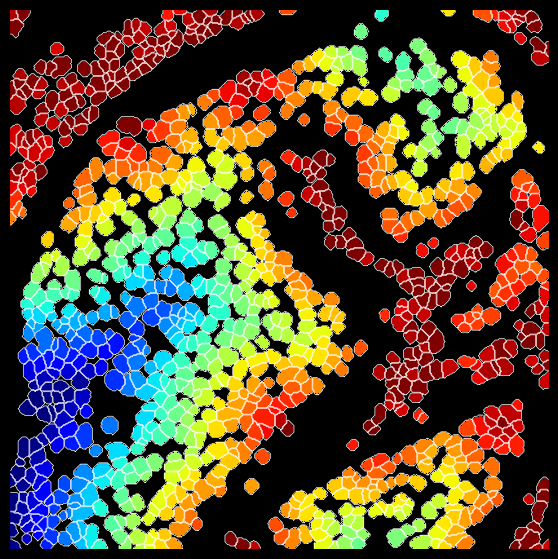

  0%|          | 0/1180 [00:00<?, ?it/s]

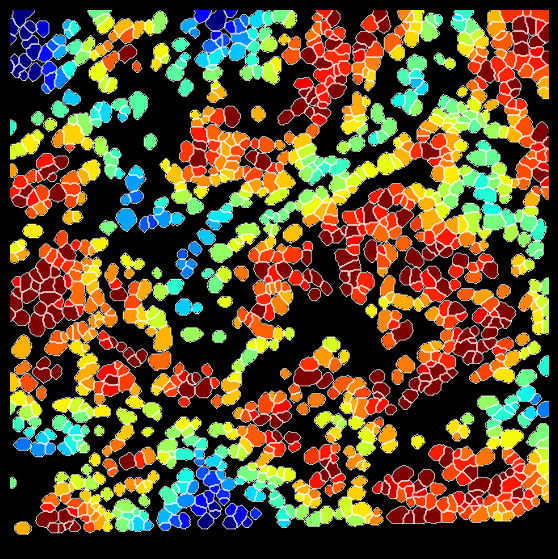

  0%|          | 0/1133 [00:00<?, ?it/s]

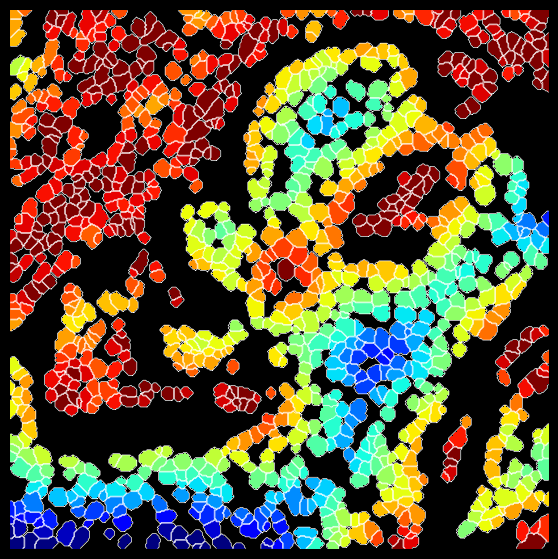

In [64]:
import warnings
warnings.filterwarnings('ignore')

attr = 'Type'
cmap_dist = 'jet_r'

for spl in datasets:
    # Get CD31 positif 
    adata_fov = adata_IMC[adata_IMC.obs['Dataset'] == spl]
    adata_ref = adata_fov[adata_fov[:,'CD31'].X > 0.05]

    # Get distance to CD31 positif cells for all cells
    try:
        d = get_distance(adata_fov, adata_ref)
    except:
        continue
    label2cell = {}
    cell_ids = adata_fov.obs.Cell.to_list()

    for i, cell in enumerate(cell_ids):
        label2cell[cell] = d[i]
        
    # Get mask and contours
    mask = masks["_".join([experiment, spl])]
    contours = get_contour(mask)    

    img = create_intensity_cell(mask, label2cell)

    # Plot
    fig, ax = plt.subplots(figsize=(7, 7), facecolor='k')
    ax.imshow(img, cmap=cmap_dist, vmin=np.nanquantile(img, 0.05), vmax=np.nanquantile(img, 0.99), alpha=1)
    ax.axis("off")
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color="white")
    plt.show()

In [65]:
# Plotting
def create_intensity_cell(mask, cell2intensity, **kwargs):
    img = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.float)*np.nan

    for cell, intensity in tqdm(cell2intensity.items(), total=len(cell2intensity)):
        rows, cols = np.where(np.isin(mask, cell))
        img[rows, cols] = intensity
    return img

  0%|          | 0/937 [00:00<?, ?it/s]

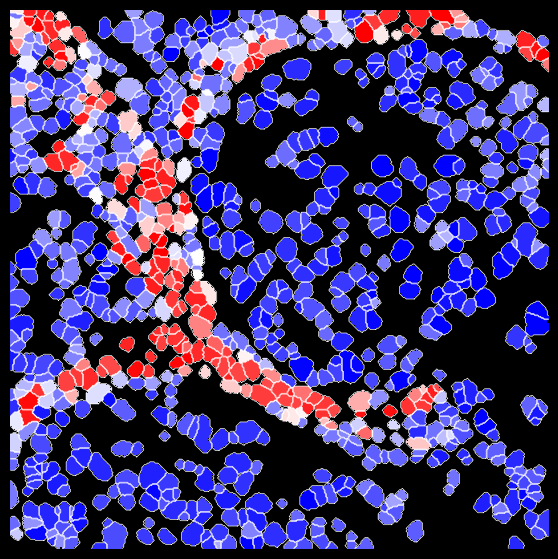

  0%|          | 0/960 [00:00<?, ?it/s]

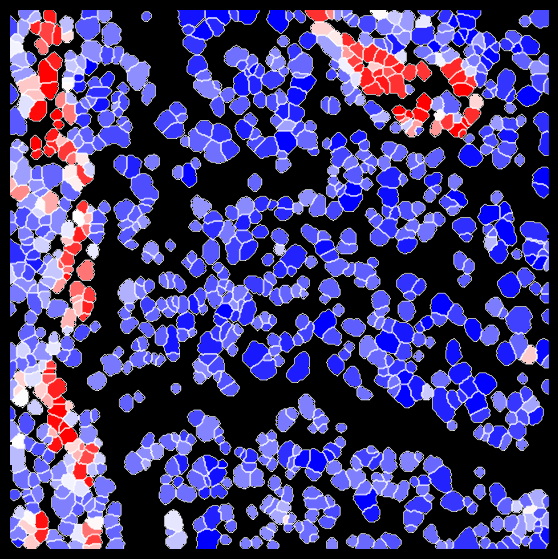

  0%|          | 0/993 [00:00<?, ?it/s]

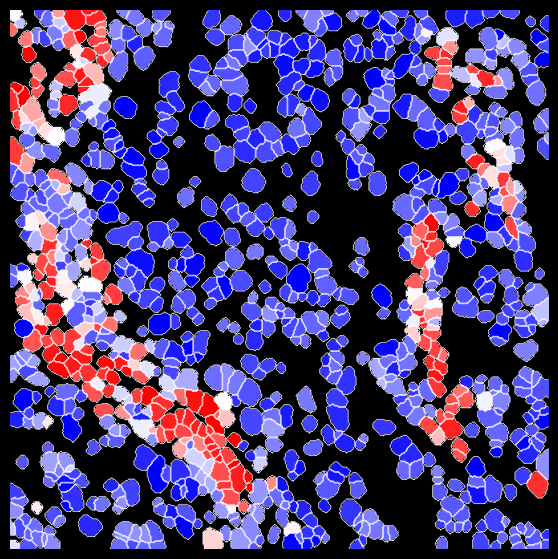

  0%|          | 0/905 [00:00<?, ?it/s]

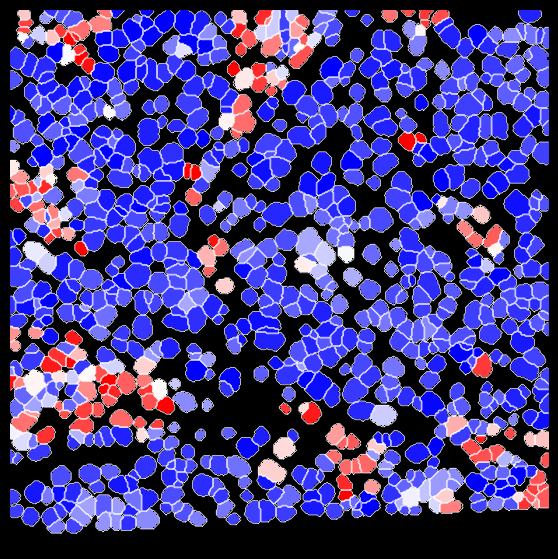

  0%|          | 0/970 [00:00<?, ?it/s]

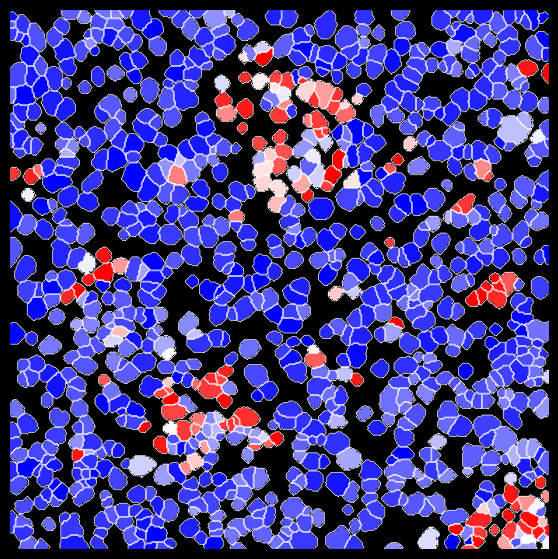

  0%|          | 0/1282 [00:00<?, ?it/s]

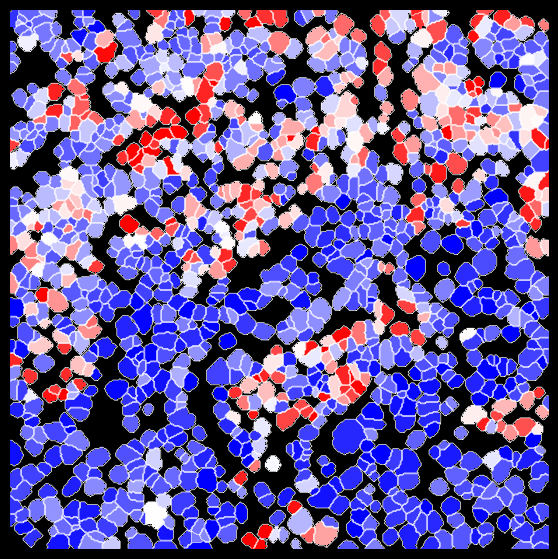

  0%|          | 0/866 [00:00<?, ?it/s]

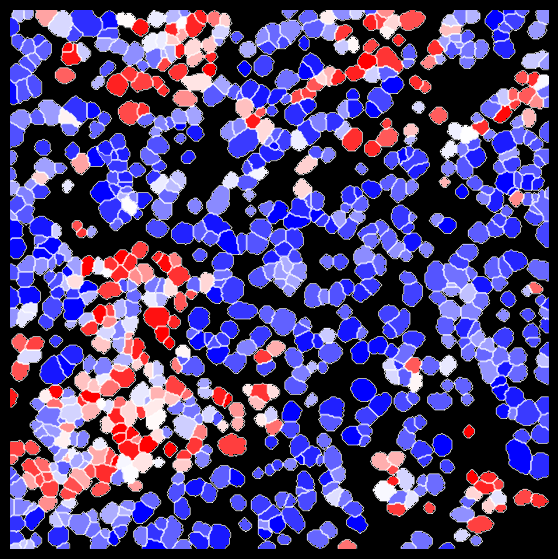

  0%|          | 0/948 [00:00<?, ?it/s]

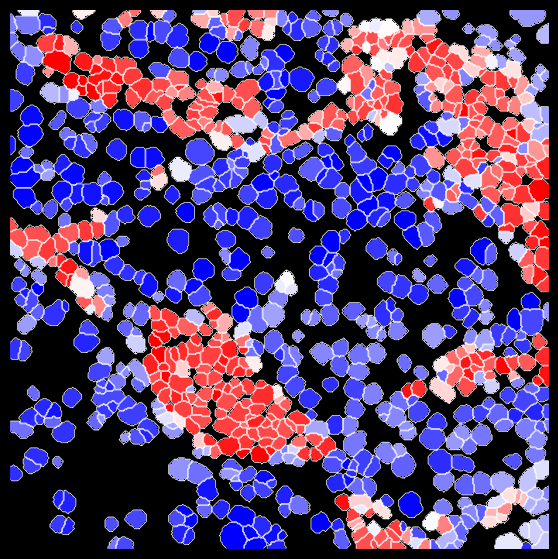

  0%|          | 0/1117 [00:00<?, ?it/s]

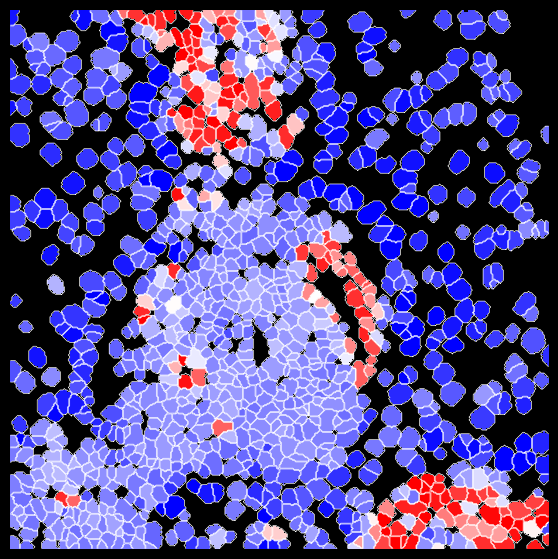

  0%|          | 0/456 [00:00<?, ?it/s]

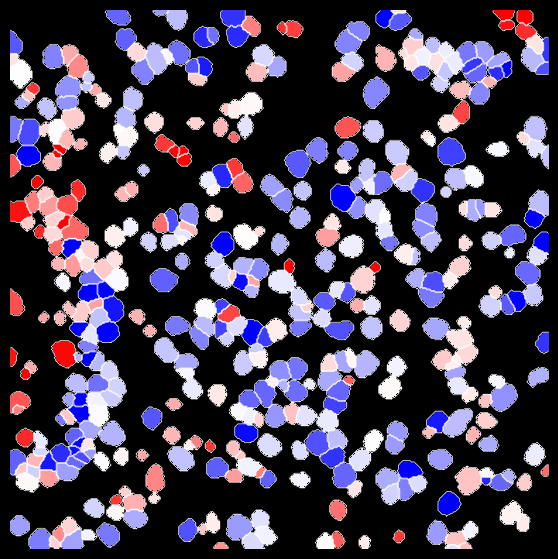

  0%|          | 0/738 [00:00<?, ?it/s]

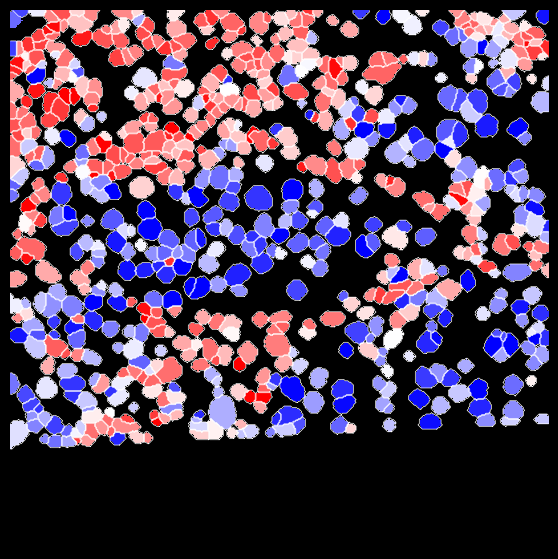

  0%|          | 0/931 [00:00<?, ?it/s]

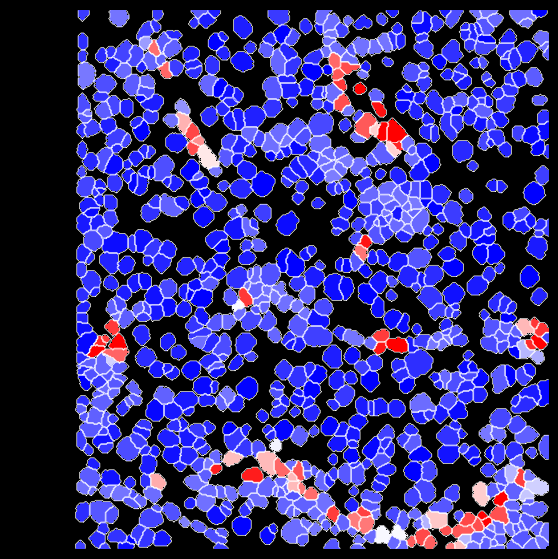

  0%|          | 0/1293 [00:00<?, ?it/s]

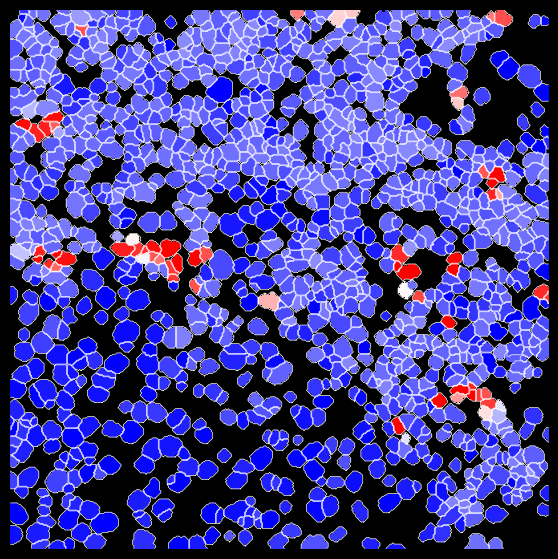

  0%|          | 0/1209 [00:00<?, ?it/s]

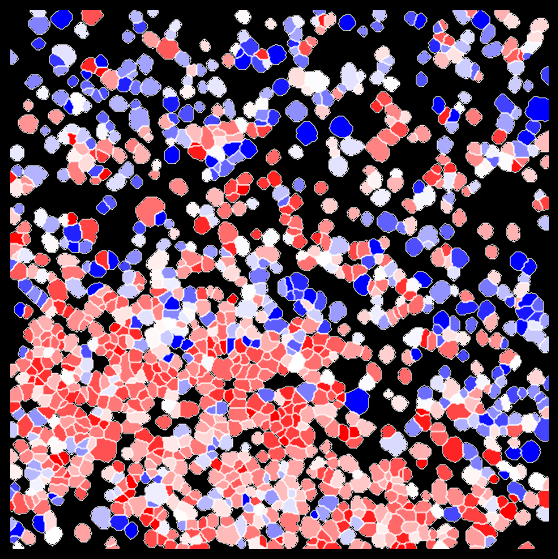

  0%|          | 0/533 [00:00<?, ?it/s]

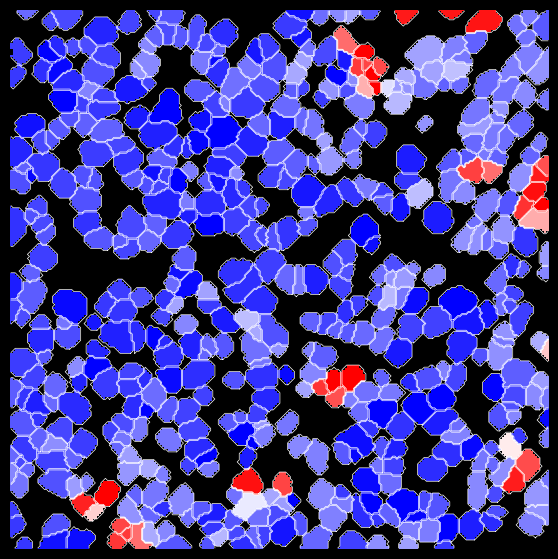

  0%|          | 0/415 [00:00<?, ?it/s]

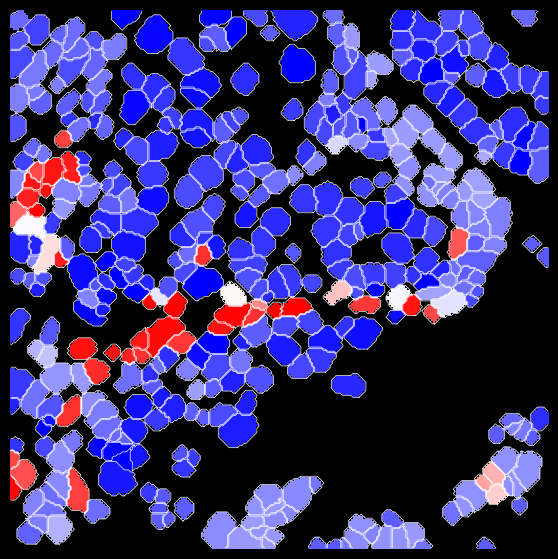

  0%|          | 0/474 [00:00<?, ?it/s]

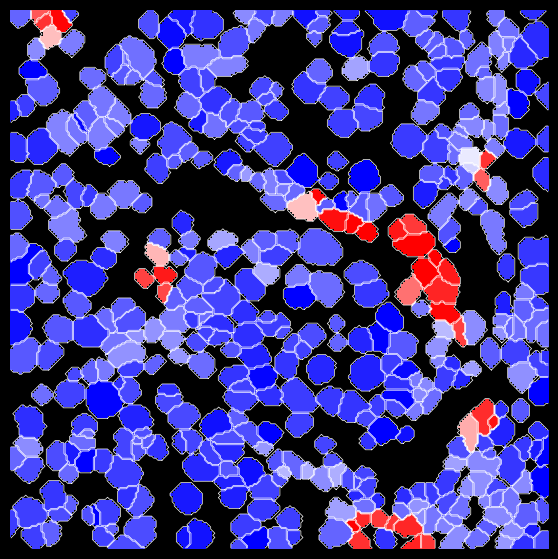

  0%|          | 0/1072 [00:00<?, ?it/s]

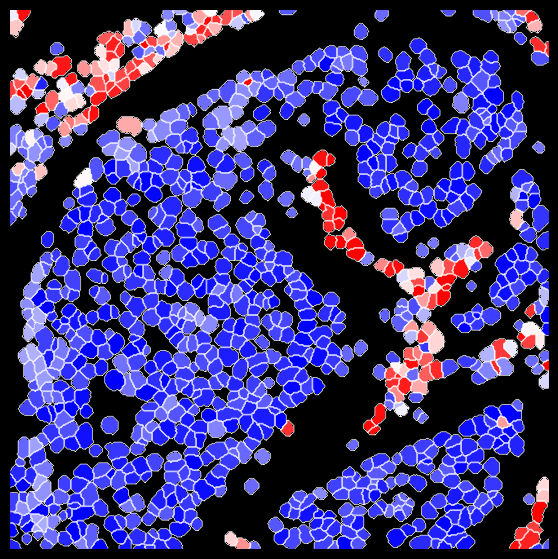

  0%|          | 0/1180 [00:00<?, ?it/s]

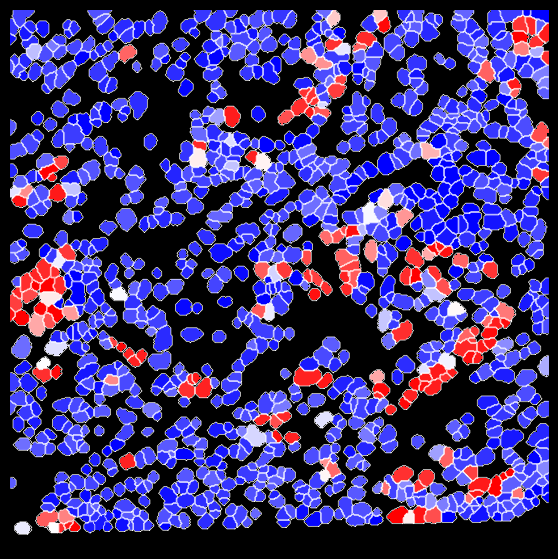

  0%|          | 0/1133 [00:00<?, ?it/s]

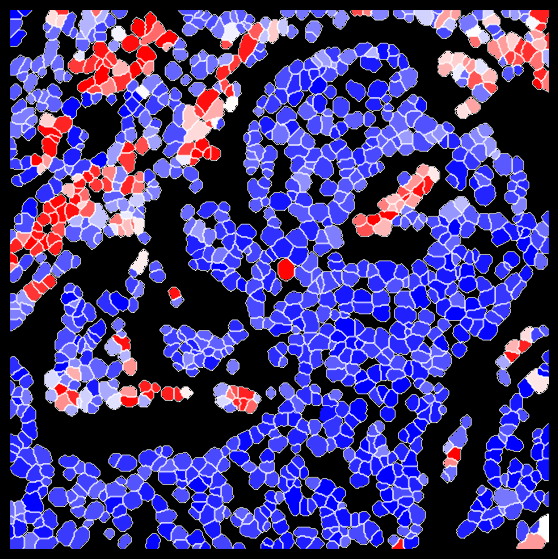

  0%|          | 0/450 [00:00<?, ?it/s]

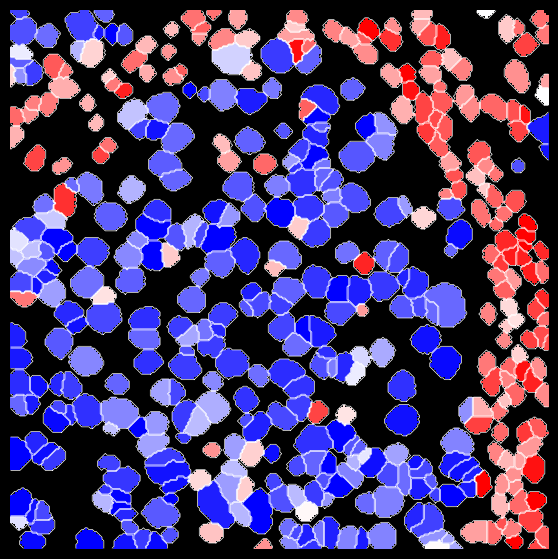

  0%|          | 0/645 [00:00<?, ?it/s]

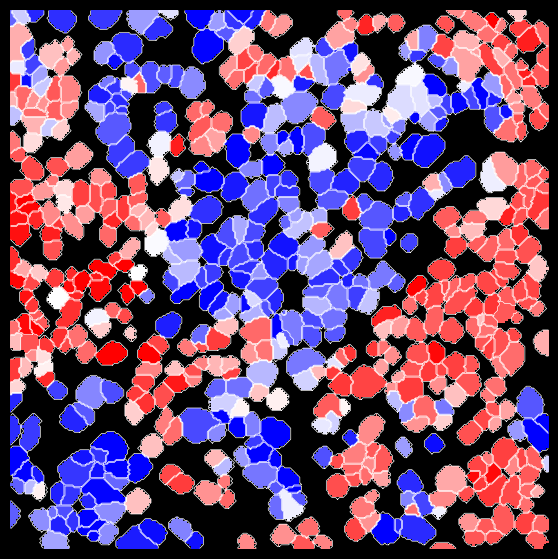

In [66]:
for spl in datasets:
    # Get CD31 positif 
    adata_fov = adata_IMC[adata_IMC.obs['Dataset'] == spl]
    # adata_ref = adata_fov[adata_fov[:,'CD31'].X > 0.1]

    label2cell = {}
    cell_ids = adata_fov.obs.Cell.to_list()
    d = adata_fov[:,'CD31'].X.flatten()
    for i, cell in enumerate(cell_ids):
        label2cell[cell] = d[i]
    
    try:
        # Get mask and contours
        mask = masks["_".join([experiment, spl])]
        contours = get_contour(mask)    

        img = create_intensity_cell(mask, label2cell)

        # Plot
        fig, ax = plt.subplots(figsize=(7, 7), facecolor='k')
        ax.imshow(img, cmap='bwr', vmin=np.nanquantile(img, 0.05), vmax=np.nanquantile(img, 0.99), alpha=1)
        ax.axis("off")
        for j, contour in enumerate(contours):
            ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color="white")
        plt.show()
    except:
        continue 

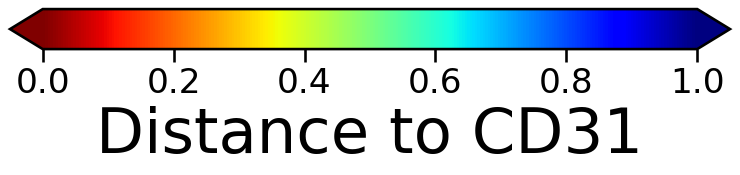

In [67]:
import matplotlib.pyplot as plt
import matplotlib as mpl
plt.rcParams.update({'font.size':20})

# Make a figure and axes with dimensions as desired.
fig = plt.figure(figsize=(8, 4))
ax1 = fig.add_axes([0.05, 0.80, 0.9, 0.1])

norm = mpl.colors.Normalize(vmin=0, vmax=1)

# Fist Cell type
cb1 = mpl.colorbar.ColorbarBase(ax1, cmap='jet_r',
                                norm=norm, extend='both',
                                orientation='horizontal')
cb1.set_label(f'Distance to CD31', fontsize=45)


# Local competition with CD31 distane

In [68]:
# Import spatial omics library
import athena as ath
from spatialOmics import SpatialOmics

# import default graph builder parameters
from athena.graph_builder.constants import GRAPH_BUILDER_DEFAULT_PARAMS
from matplotlib.colors import ListedColormap

In [69]:
import networkx as nx
import numpy as np
import pandas as pd
from typing import List
import matplotlib
import skimage
from skimage import measure

def get_node_interactions(g: nx.Graph, data: pd.Series = None):
    # NOTE: The data pd.Series is categorical with globally all categories

    source, neighs = [], []
    for i in g.nodes:
        if len(g[i]) > 0:  # some nodes might have no neighbors
            source.append(i)
            neighs.append(list(g[i]))

    node_interactions = pd.DataFrame({'source': source, 'target': neighs}).explode('target')
    if data is not None:
        node_interactions['source_label'] = data.loc[node_interactions.source].values
        node_interactions['target_label'] = data.loc[node_interactions.target].values

    return node_interactions

def get_interaction_type(node_interactions: pd.DataFrame, interaction=('GC B-cell', 'FDC')):
    
    # Get rid of source == target rows
    nint = node_interactions[~(node_interactions.source == node_interactions.target)]
    
    # Only need to look at one interaction direction A->B because B->A will be symetric
    (a1, a2) = interaction
    nint_filtered1 = nint[(nint.source_label == a1) & (nint.target_label == a2)]
    nint_filtered2 = nint[(nint.source_label == a2) & (nint.target_label == a1)]
    return pd.concat([nint_filtered1, nint_filtered2])


# Plotting
def create_clustered_cell(mask, label2cell, my_cmap, **kwargs):
    img = np.zeros((mask.shape[0], mask.shape[1], 3), dtype=np.uint8)

    for i, cells in tqdm(label2cell.items(), total=len(label2cell)):
        rows, cols = np.where(np.isin(mask, cells))
        img[rows, cols, :] = my_cmap[int(i)]

    return img


def get_contour(mask: np.ndarray) -> List[List[float]]:
    """
    Get contours of mask
    """
    contours = []
    for i in sorted(np.unique(mask)):
        if i == 0:
            continue
        contours.append(measure.find_contours(mask == i, 0.8)[0])

    return contours



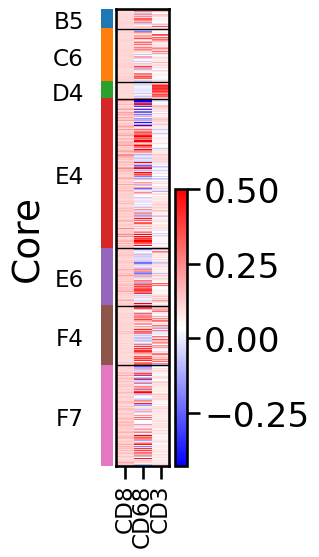

In [70]:
sc.pl.heatmap(adata_IMC[adata_IMC[:,'CD8'].X > 0.1], ['CD8', 'CD68', 'CD3'], groupby='Core', cmap='bwr', vmax=0.5)

In [71]:
type_new = adata_IMC.obs['Type'].to_numpy()
type_new[(adata_IMC[:,'CD3'].X > 0.1).flatten().tolist()] = 'CD3+'
adata_IMC.obs['Type_new'] = type_new
adata_IMC.obs['Type_new'] = adata_IMC.obs['Type_new'].astype('category')

In [72]:
# Create spatial omics data objects

spadata = SpatialOmics()
spl = pd.DataFrame({'Dataset': adata_IMC.obs.Dataset.unique()})
spadata.spl = spl

for d in adata_IMC.obs.Dataset.unique():
    adata_subset = adata_IMC[adata_IMC.obs.Dataset == d, :]
    
    obs = adata_subset.obs.copy()
    obs['x'] = adata_subset.obsm['spatial'][:,1].tolist()
    obs['y'] = adata_subset.obsm['spatial'][:,0].tolist()
    obs['cell_id'] = obs['Cell']
    obs = obs.set_index('cell_id')
    spadata.obs[d] = obs
    spadata.X[d] = pd.DataFrame(adata_subset.X, columns=adata_subset.var_names, index=adata_subset.obs.Cell.tolist())
    spadata.var[d] = adata_subset.var
    spadata.masks[d] = {'cellmasks': masks["_".join([experiment, d])]}

In [73]:
# Loop through all region and create different cell neighborhood graph
datasets = spadata.spl.Dataset

for spl in datasets:
    # kNN graph
    config = GRAPH_BUILDER_DEFAULT_PARAMS['knn']
    config['builder_params']['n_neighbors'] = 5 # set parameter k
    ath.graph.build_graph(spadata, spl, builder_type='knn', mask_key='cellmasks', config=config)

    # Radius graph
    config = GRAPH_BUILDER_DEFAULT_PARAMS['radius']
    config['builder_params']['radius'] = 20 # set radius
    ath.graph.build_graph(spadata, spl, builder_type='radius', mask_key='cellmasks', config=config)


  0%|          | 0/72 [00:00<?, ?it/s]

  0%|          | 0/54 [00:00<?, ?it/s]

  0%|          | 0/937 [00:00<?, ?it/s]

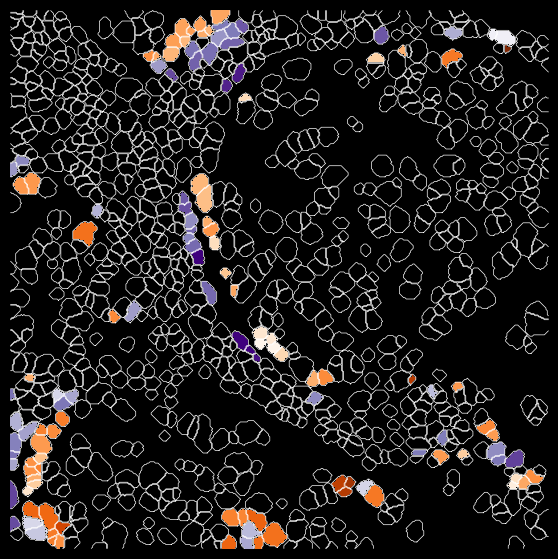

  0%|          | 0/46 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/960 [00:00<?, ?it/s]

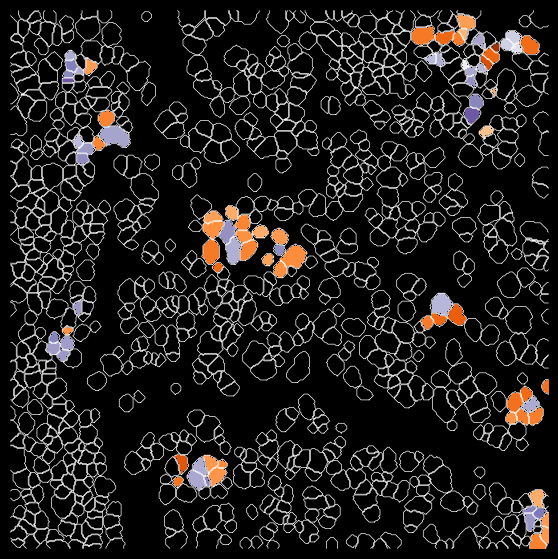

  0%|          | 0/82 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

  0%|          | 0/993 [00:00<?, ?it/s]

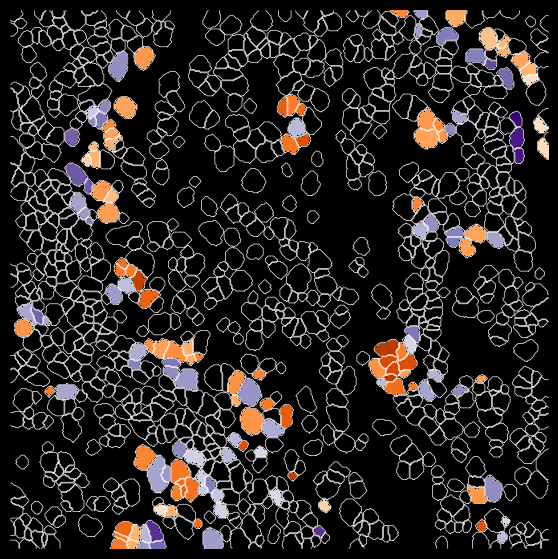

  0%|          | 0/70 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/905 [00:00<?, ?it/s]

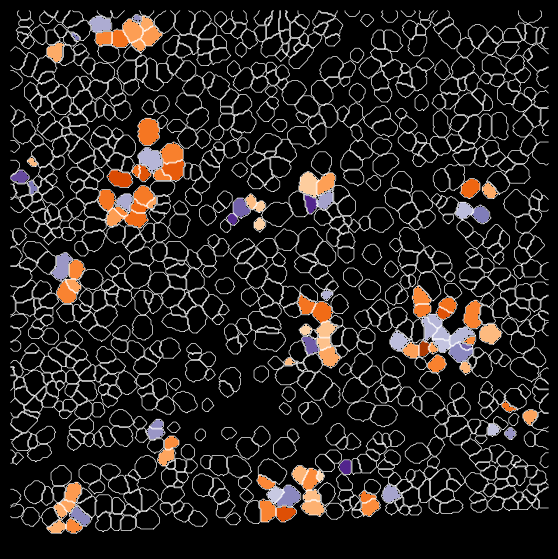

  0%|          | 0/123 [00:00<?, ?it/s]

  0%|          | 0/44 [00:00<?, ?it/s]

  0%|          | 0/970 [00:00<?, ?it/s]

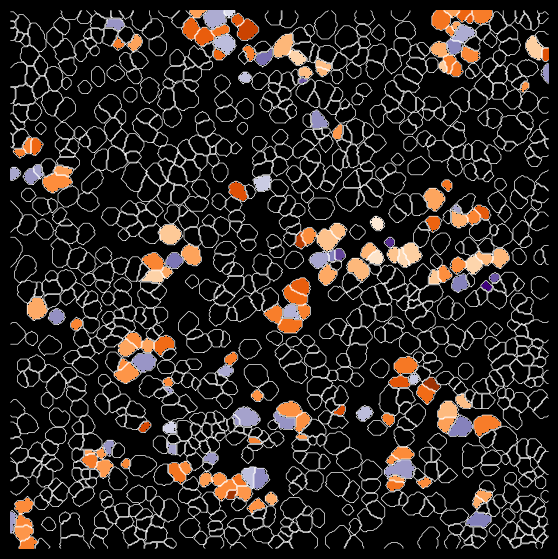

  0%|          | 0/95 [00:00<?, ?it/s]

  0%|          | 0/86 [00:00<?, ?it/s]

  0%|          | 0/1282 [00:00<?, ?it/s]

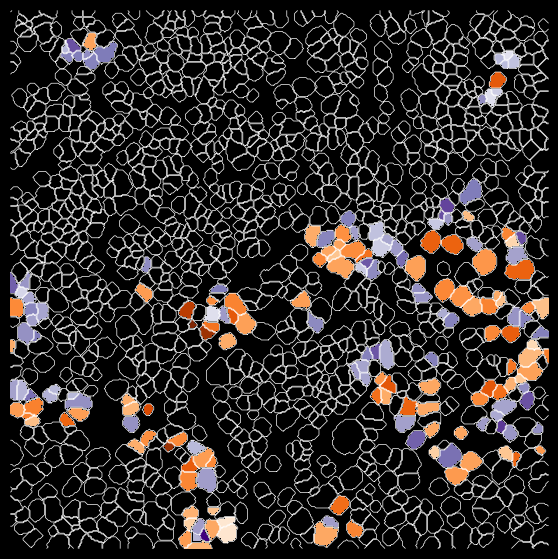

  0%|          | 0/60 [00:00<?, ?it/s]

  0%|          | 0/38 [00:00<?, ?it/s]

  0%|          | 0/866 [00:00<?, ?it/s]

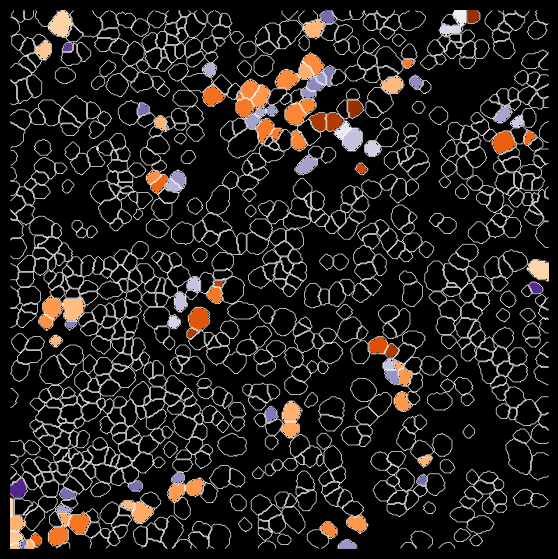

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/54 [00:00<?, ?it/s]

  0%|          | 0/948 [00:00<?, ?it/s]

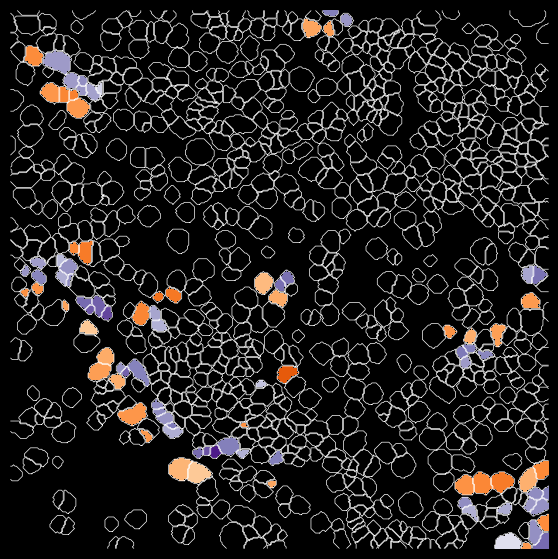

  0%|          | 0/61 [00:00<?, ?it/s]

  0%|          | 0/82 [00:00<?, ?it/s]

  0%|          | 0/1117 [00:00<?, ?it/s]

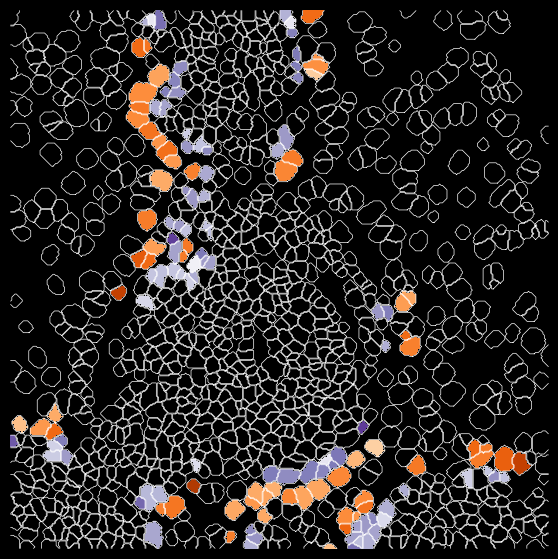

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/132 [00:00<?, ?it/s]

  0%|          | 0/116 [00:00<?, ?it/s]

  0%|          | 0/194 [00:00<?, ?it/s]

  0%|          | 0/146 [00:00<?, ?it/s]

  0%|          | 0/931 [00:00<?, ?it/s]

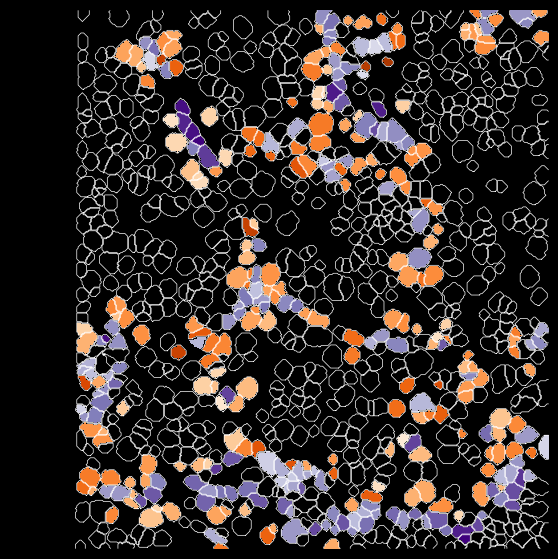

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/1293 [00:00<?, ?it/s]

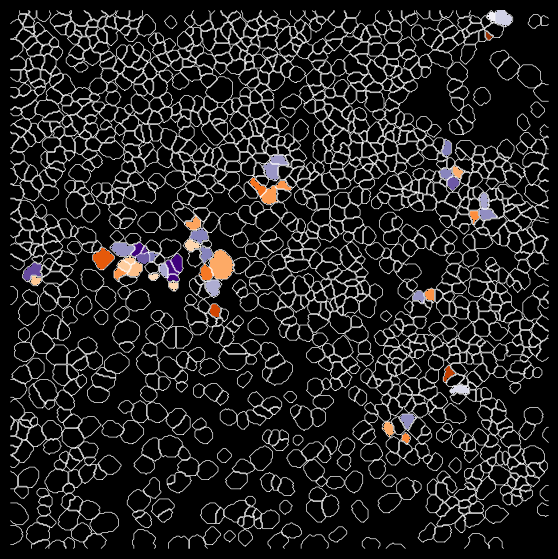

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/47 [00:00<?, ?it/s]

  0%|          | 0/43 [00:00<?, ?it/s]

  0%|          | 0/533 [00:00<?, ?it/s]

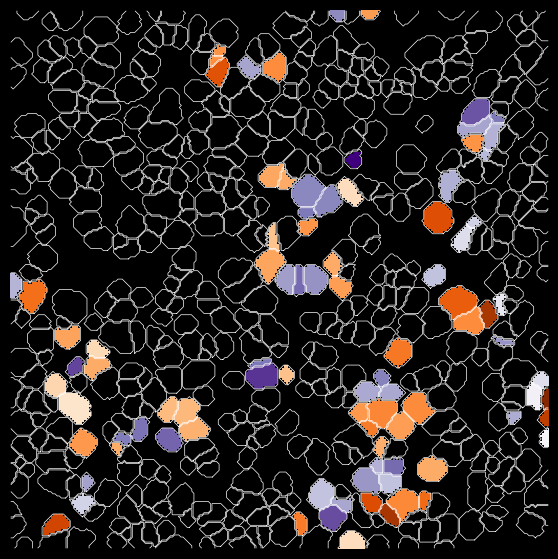

  0%|          | 0/46 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/415 [00:00<?, ?it/s]

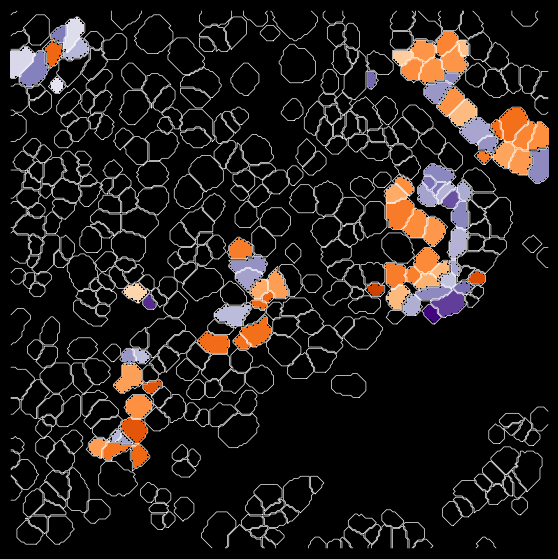

  0%|          | 0/99 [00:00<?, ?it/s]

  0%|          | 0/72 [00:00<?, ?it/s]

  0%|          | 0/474 [00:00<?, ?it/s]

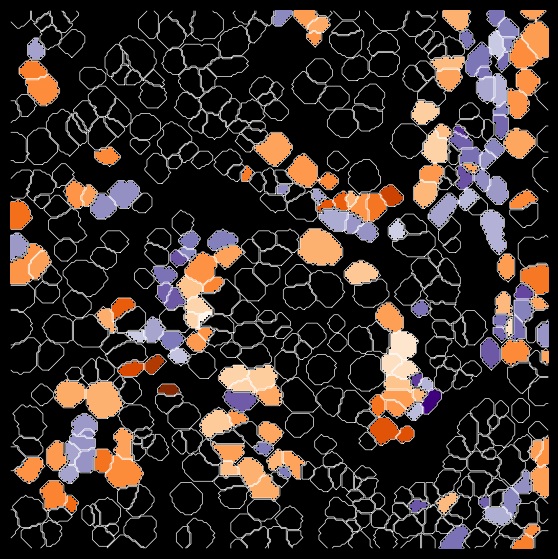

  0%|          | 0/210 [00:00<?, ?it/s]

  0%|          | 0/67 [00:00<?, ?it/s]

  0%|          | 0/1072 [00:00<?, ?it/s]

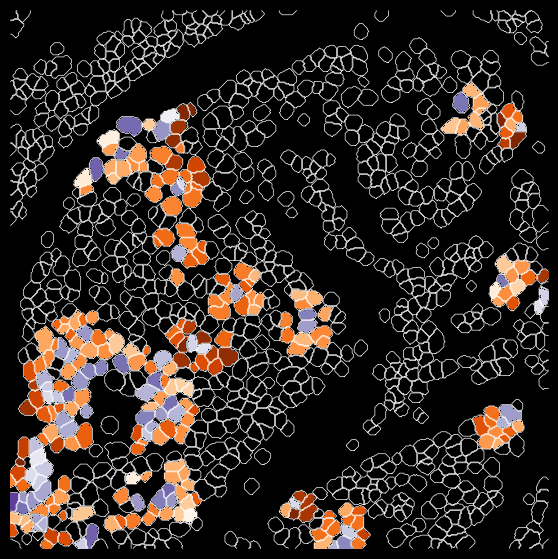

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/1180 [00:00<?, ?it/s]

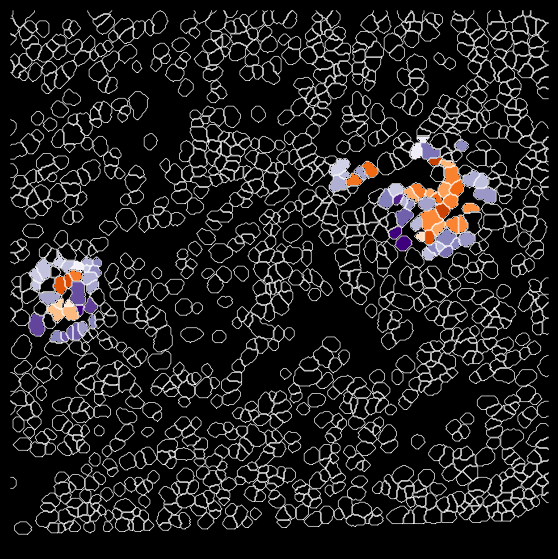

  0%|          | 0/181 [00:00<?, ?it/s]

  0%|          | 0/63 [00:00<?, ?it/s]

  0%|          | 0/1133 [00:00<?, ?it/s]

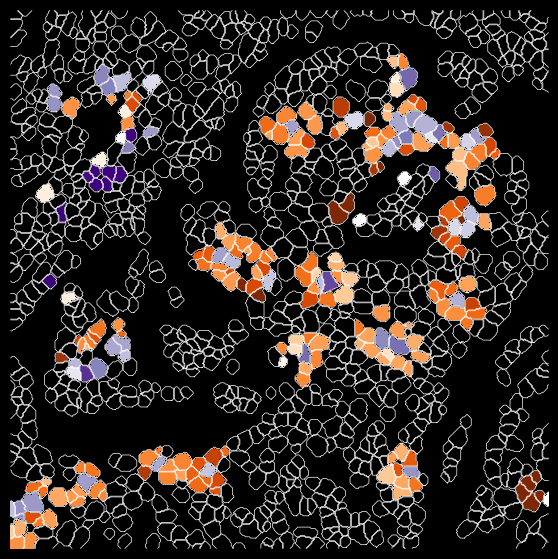

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

In [74]:
import warnings
warnings.filterwarnings('ignore')

attr = 'Type_new'
interaction=('Tumor', 'CD3+')
cmap1 = 'Oranges'
cmap2 = 'Purples'
cmap_dist = 'cividis_r'
mz = '42.0m/z Lipid'

ct1_ratios = []
ct2_ratios = []
distance_ct1 = []
distance_ct2 = []

for spl in datasets:
    # Get sims 
    adata_sims_subset = adata_raw[adata_raw.obs.Dataset == spl]
    df_sims = pd.DataFrame(adata_sims_subset.X, columns=adata_sims_subset.var_names, index=adata_sims_subset.obs.Cell)

    # Get Graph info
    G = spadata.G[spl]['radius']
    
    # Extract cell interactions
    data = spadata.obs[spl][attr]
    node_interactions = get_node_interactions(G, data)

    # Get specific interationcs
    interactions = get_interaction_type(node_interactions, interaction)
    
    if len(interactions) == 0:
        print(f"{spl} no interactions")
        continue 
        
    # Extract cell id
    cells  = np.unique(pd.concat([interactions.source, interactions.target]))
    
    # Get ratio per cell neighbors
    group = interactions.groupby(['source_label'])
    ratios = []

    for source, df_group in group:
        group_cell = df_group.groupby(['source'])
        for cell_id, df_cell in group_cell:
            # Get metabolites count on cell vs neighbor
            nei_list = df_cell.target.tolist()
            cell_sims = df_sims.loc[cell_id]
            nei_sims = df_sims.loc[nei_list]
            ratio = cell_sims.div(nei_sims.mean())
            ratios.append(pd.DataFrame(ratio, columns=[cell_id]).T)

    ratios = pd.concat(ratios)        
    assert ratios.index.duplicated().all() == False
    
    # Get mask and contour
    mask = masks["_".join([experiment, spl])]
    contours = get_contour(mask)
    
    # Get ratios
    cell_type1 = interactions[interactions['source_label'] == interaction[0]].source.tolist()
    ratios_ct1 = ratios.loc[cell_type1]
    cell2intensity = ratios_ct1[mz].to_dict()
    img1 = create_intensity_cell(mask, cell2intensity)

    cell_type2 = interactions[interactions['source_label'] == interaction[1]].source.tolist()
    ratios_ct2 = ratios.loc[cell_type2]
    cell2intensity = ratios_ct2[mz].to_dict()
    img2 = create_intensity_cell(mask, cell2intensity)
    
    # Get CD31 positif 
    adata_fov = adata_IMC[adata_IMC.obs['Dataset'] == spl]
    adata_ref = adata_fov[adata_fov[:,'CD31'].X > 0.05]
    
    try:
        d = get_distance(adata_fov, adata_ref)
    except:
        continue
    label2cell = {}
    cell_ids = adata_fov.obs.Cell.to_list()

    for i, cell in enumerate(cell_ids):
        label2cell[cell] = d[i]

    img = create_intensity_cell(mask, label2cell)

    # Plot
    fig, ax = plt.subplots(figsize=(7, 7), facecolor='k')
    # ax.imshow(img, cmap=cmap_dist, vmax=np.nanquantile(img, 0.95), alpha=0.5)
    ax.axis("off")
    ax.imshow(img1, cmap=cmap1, vmin=0.6, vmax=1.4)
    ax.imshow(img2, cmap=cmap2, vmin=0.6, vmax=1.4)
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color="white")
    
    # fig.savefig(f'D31_{mz[:4]}_{interaction}_{spl}.png',bbox_inches='tight',transparent=True, pad_inches=0)
    plt.show()
    
    # Add info to ratios
    ct1_ratios.append(ratios_ct1)
    ct2_ratios.append(ratios_ct2)
    distance_ct1.append(np.array([label2cell[c] for c in cell_type1]).flatten())
    distance_ct2.append(np.array([label2cell[c] for c in cell_type2]).flatten())
    

In [75]:
# Summary plot
ct1_ratio = pd.concat(ct1_ratios)
ct2_ratio = pd.concat(ct2_ratios)
dist_ct1 = np.concatenate(distance_ct1)
dist_ct2 = np.concatenate(distance_ct2)

ct1_ratio['Distance CD31'] = dist_ct1
ct2_ratio['Distance CD31'] = dist_ct2

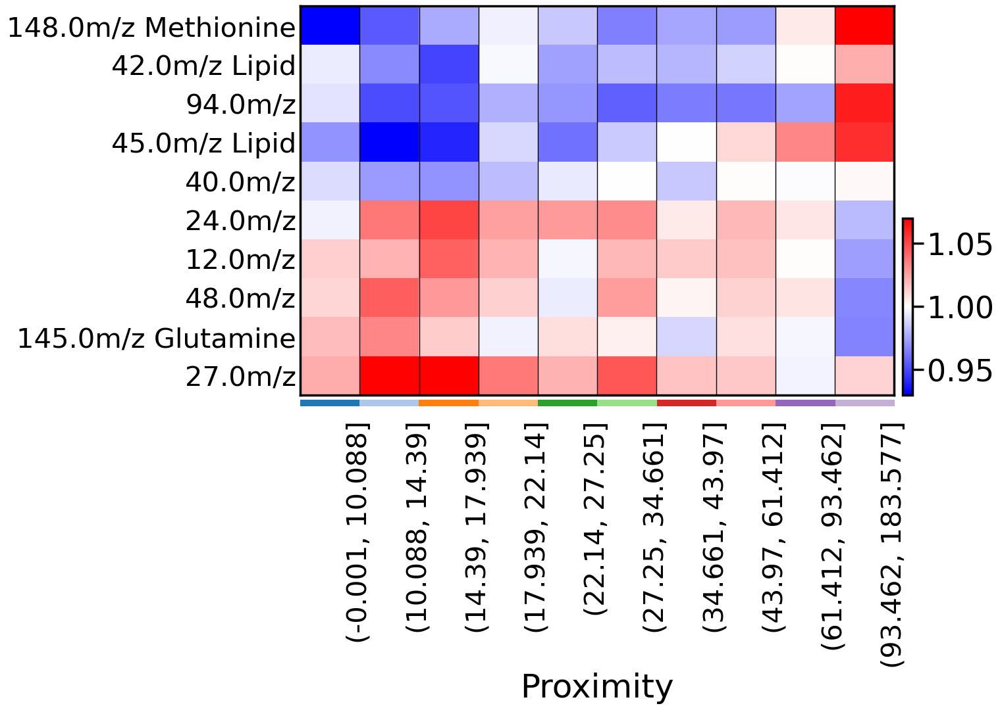

In [76]:
df = ct1_ratio
df_corr = df.corr()

n = 5
marker = 'Distance CD31'
n_cut = 10

# Get positive and negative correlation
corr_pos = df_corr.loc[marker].nlargest(25).index.tolist()
corr_neg = df_corr.loc[marker].nsmallest(25).index.tolist()

# Get only SIMS masses
corr_pos = [corr for corr in corr_pos if corr in SIMS_nm_subset][:n]
corr_neg = [corr for corr in corr_neg if corr in SIMS_nm_subset][:n]
corr_list = [marker] + corr_pos + corr_neg

# Get range 
df_intensity = df[corr_list]
df_intensity.sort_values(by=[marker], inplace=True)
df_intensity[f'{marker} cut'] = pd.qcut(df_intensity[marker], n_cut, duplicates='drop') 

# Sort by Distance
df_sort = df_intensity.groupby(f'{marker} cut').median()
df_sort = df_sort.drop([marker], axis=1)

# create adata
adata_cd31_corr = sc.AnnData(df_sort)
adata_cd31_corr.var_names = df_sort.columns.tolist()
adata_cd31_corr.obs['Proximity'] = df_sort.index.tolist()

with sns.plotting_context('poster', font_scale=1.5):
    sc.pl.heatmap(adata_cd31_corr, adata_cd31_corr.var_names, groupby='Proximity', swap_axes=True, cmap='bwr', figsize=(12,8), vmin=0.93, vmax=1.07)

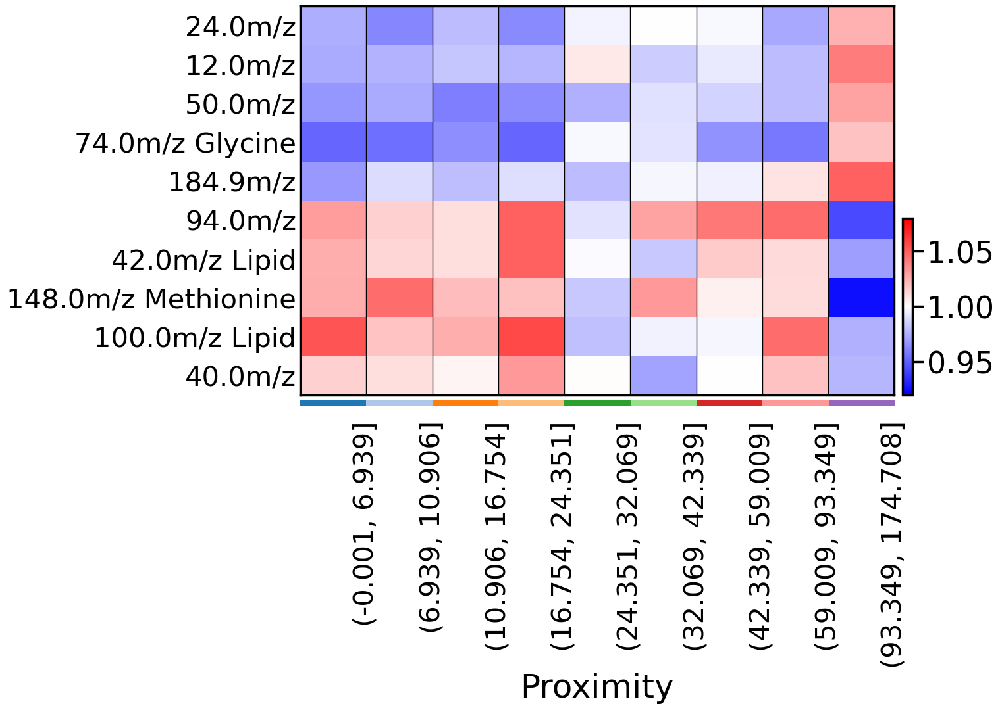

In [77]:
df = ct2_ratio
df_corr = df.corr()

n = 5
marker = 'Distance CD31'
n_cut = 10

# Get positive and negative correlation
corr_pos = df_corr.loc[marker].nlargest(25).index.tolist()
corr_neg = df_corr.loc[marker].nsmallest(25).index.tolist()

# Get only SIMS masses
corr_pos = [corr for corr in corr_pos if corr in SIMS_nm_subset][:n]
corr_neg = [corr for corr in corr_neg if corr in SIMS_nm_subset][:n]
corr_list = [marker] + corr_pos + corr_neg

# Get range 
df_intensity = df[corr_list]
df_intensity.sort_values(by=[marker], inplace=True)
df_intensity[f'{marker} cut'] = pd.qcut(df_intensity[marker], n_cut, duplicates='drop') 

# Sort by Distance
df_sort = df_intensity.groupby(f'{marker} cut').median()
df_sort = df_sort.drop([marker], axis=1)

# create adata
adata_cd31_corr = sc.AnnData(df_sort)
adata_cd31_corr.var_names = df_sort.columns.tolist()
adata_cd31_corr.obs['Proximity'] = df_sort.index.tolist()

with sns.plotting_context('poster', font_scale=1.5):
    sc.pl.heatmap(adata_cd31_corr, adata_cd31_corr.var_names, groupby='Proximity', swap_axes=True, cmap='bwr', figsize=(12,8), vmin=0.92, vmax=1.08)

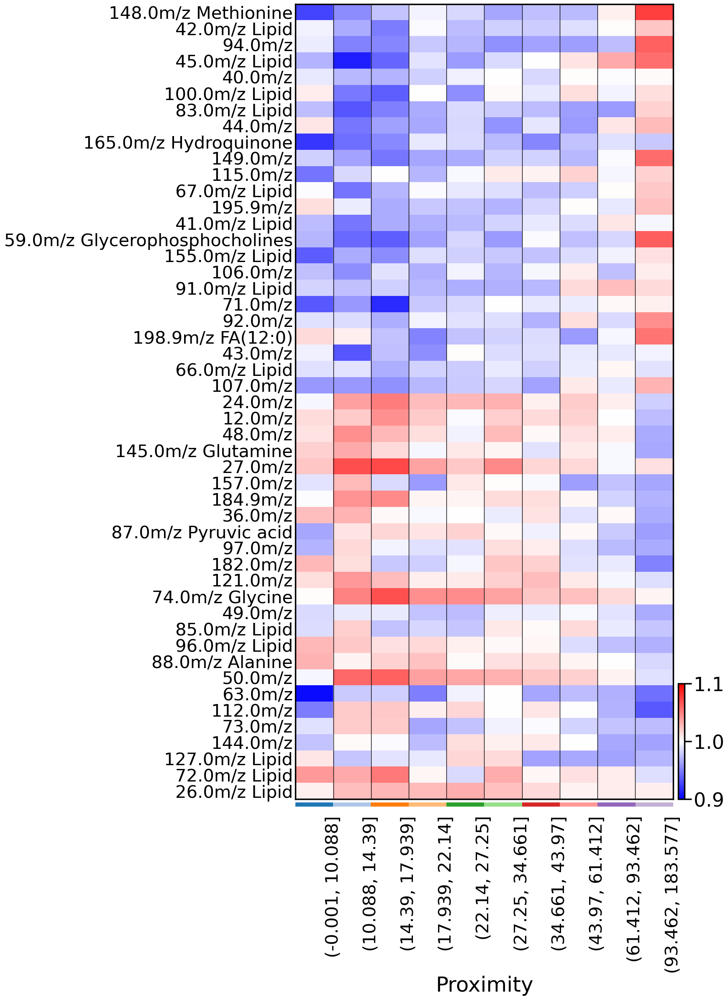

In [78]:
df = ct1_ratio
df_corr = df.corr()

n = 25
marker = 'Distance CD31'
n_cut = 10

# Get positive and negative correlation
corr_pos = df_corr.loc[marker].nlargest(25).index.tolist()
corr_neg = df_corr.loc[marker].nsmallest(25).index.tolist()

# Get only SIMS masses
corr_pos = [corr for corr in corr_pos if corr in SIMS_nm_subset][:n]
corr_neg = [corr for corr in corr_neg if corr in SIMS_nm_subset][:n]
corr_list = [marker] + corr_pos + corr_neg

# Get range 
df_intensity = df[corr_list]
df_intensity.sort_values(by=[marker], inplace=True)
df_intensity[f'{marker} cut'] = pd.qcut(df_intensity[marker], n_cut, duplicates='drop') 

# Sort by Distance
df_sort = df_intensity.groupby(f'{marker} cut').median()
df_sort = df_sort.drop([marker], axis=1)

# create adata
adata_cd31_corr = sc.AnnData(df_sort)
adata_cd31_corr.var_names = df_sort.columns.tolist()
adata_cd31_corr.obs['Proximity'] = df_sort.index.tolist()

with sns.plotting_context('poster', font_scale=1.5):
    sc.pl.heatmap(adata_cd31_corr, adata_cd31_corr.var_names, groupby='Proximity', swap_axes=True, cmap='bwr', figsize=(12,25), vmin=0.9, vmax=1.1)

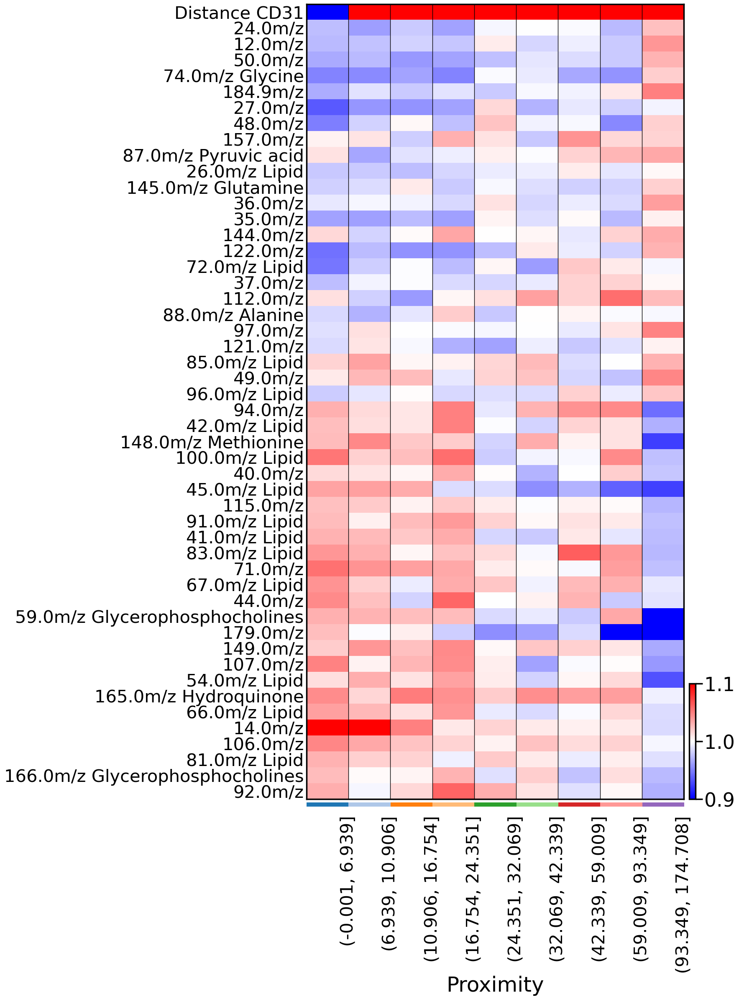

In [79]:
df = ct2_ratio
df_corr = df.corr()

n = 25
marker = 'Distance CD31'
n_cut = 10

# Get positive and negative correlation
corr_pos = df_corr.loc[marker].nlargest(25).index.tolist()
corr_neg = df_corr.loc[marker].nsmallest(25).index.tolist()

# Get only SIMS masses
corr_pos = [corr for corr in corr_pos if corr in SIMS_nm_subset][:n]
corr_neg = [corr for corr in corr_neg if corr in SIMS_nm_subset][:n]
corr_list = [marker] + corr_pos + corr_neg

# Get range 
df_intensity = df[corr_list]
df_intensity.sort_values(by=[marker], inplace=True)
df_intensity[f'{marker} cut'] = pd.qcut(df_intensity[marker], n_cut, duplicates='drop') 

# Sort by Distance
df_sort = df_intensity.groupby(f'{marker} cut').median()

# create adata
adata_cd31_corr = sc.AnnData(df_sort)
adata_cd31_corr.var_names = df_sort.columns.tolist()
adata_cd31_corr.obs['Proximity'] = df_sort.index.tolist()

with sns.plotting_context('poster', font_scale=1.5):
    sc.pl.heatmap(adata_cd31_corr, adata_cd31_corr.var_names, groupby='Proximity', swap_axes=True, cmap='bwr', figsize=(12,25), vmin=0.9, vmax=1.1)

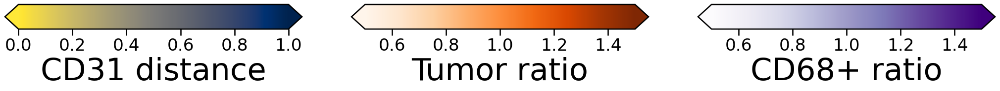

In [80]:
import matplotlib.pyplot as plt
import matplotlib as mpl
plt.rcParams.update({'font.size':20})

# Make a figure and axes with dimensions as desired.
fig = plt.figure(figsize=(20, 5))
ax1 = fig.add_axes([0.0, 0.15, 0.3, 0.1])
ax2 = fig.add_axes([0.35, 0.15, 0.3, 0.1])
ax3 = fig.add_axes([0.7, 0.15, 0.3, 0.1])

norm = mpl.colors.Normalize(vmin=0.5, vmax=1.5)

# Fist Cell type
cb1 = mpl.colorbar.ColorbarBase(ax2, cmap=cmap1,
                                norm=norm, extend='both',
                                orientation='horizontal')
cb1.set_label(f'{interaction[0]} ratio', fontsize=45)

# 2nd Cell type
cb2 = mpl.colorbar.ColorbarBase(ax3, cmap=cmap2,
                                norm=norm, extend='both',
                                orientation='horizontal')
cb2.set_label(f'CD68+ ratio', fontsize=45)

# Distance map
norm = mpl.colors.Normalize(vmin=0, vmax=1)

cb3 = mpl.colorbar.ColorbarBase(ax1, cmap=cmap_dist,
                                norm=norm,  extend='both',
                                orientation='horizontal')
cb3.set_label(f'CD31 distance', fontsize=45)

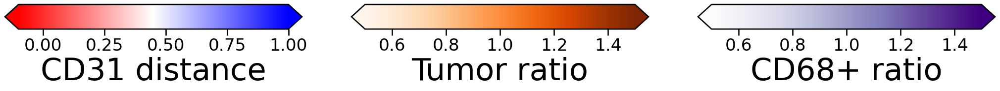

In [81]:
import matplotlib.pyplot as plt
import matplotlib as mpl
plt.rcParams.update({'font.size':20})

# Make a figure and axes with dimensions as desired.
fig = plt.figure(figsize=(20, 5))
ax1 = fig.add_axes([0.0, 0.15, 0.3, 0.1])
ax2 = fig.add_axes([0.35, 0.15, 0.3, 0.1])
ax3 = fig.add_axes([0.7, 0.15, 0.3, 0.1])

norm = mpl.colors.Normalize(vmin=0.5, vmax=1.5)

# Fist Cell type
cb1 = mpl.colorbar.ColorbarBase(ax2, cmap=cmap1,
                                norm=norm, extend='both',
                                orientation='horizontal')
cb1.set_label(f'{interaction[0]} ratio', fontsize=45)

# 2nd Cell type
cb2 = mpl.colorbar.ColorbarBase(ax3, cmap=cmap2,
                                norm=norm, extend='both',
                                orientation='horizontal')
cb2.set_label(f'CD68+ ratio', fontsize=45)

# Distance map
norm = mpl.colors.Normalize(vmin=1, vmax=0)

cb3 = mpl.colorbar.ColorbarBase(ax1, cmap='bwr_r',
                                norm=norm,  extend='both',
                                orientation='horizontal')
cb3.set_label(f'CD31 distance', fontsize=45)

# Competition variation across tissue

In [82]:
type_new = adata_IMC.obs['Type'].to_numpy()
type_new[(adata_IMC[:,'CD8'].X > 0.1).flatten().tolist()] = 'CD8+'
adata_IMC.obs['Type_new'] = type_new
adata_IMC.obs['Type_new'] = adata_IMC.obs['Type_new'].astype('category')

In [83]:
# Create spatial omics data objects

spadata = SpatialOmics()
spl = pd.DataFrame({'Dataset': adata_IMC.obs.Dataset.unique()})
spadata.spl = spl

for d in adata_IMC.obs.Dataset.unique():
    adata_subset = adata_IMC[adata_IMC.obs.Dataset == d, :]
    
    obs = adata_subset.obs.copy()
    obs['x'] = adata_subset.obsm['spatial'][:,1].tolist()
    obs['y'] = adata_subset.obsm['spatial'][:,0].tolist()
    obs['cell_id'] = obs['Cell']
    obs = obs.set_index('cell_id')
    spadata.obs[d] = obs
    spadata.X[d] = pd.DataFrame(adata_subset.X, columns=adata_subset.var_names, index=adata_subset.obs.Cell.tolist())
    spadata.var[d] = adata_subset.var
    spadata.masks[d] = {'cellmasks': masks["_".join([experiment, d])]}

In [84]:
# Loop through all region and create different cell neighborhood graph
datasets = spadata.spl.Dataset

for spl in datasets:
    # kNN graph
    config = GRAPH_BUILDER_DEFAULT_PARAMS['knn']
    config['builder_params']['n_neighbors'] = 5 # set parameter k
    ath.graph.build_graph(spadata, spl, builder_type='knn', mask_key='cellmasks', config=config)

    # Radius graph
    config = GRAPH_BUILDER_DEFAULT_PARAMS['radius']
    config['builder_params']['radius'] = 20 # set radius
    ath.graph.build_graph(spadata, spl, builder_type='radius', mask_key='cellmasks', config=config)


In [85]:
import warnings
warnings.filterwarnings('ignore')

attr = 'Type_new'
interaction=('Tumor', 'CD8+')
cmap1 = 'Oranges'
cmap2 = 'Purples'
cmap_dist = 'cividis_r'
mz = '42.0m/z Lipid'

ct1_ratios = []
ct2_ratios = []
distance_ct1 = []
distance_ct2 = []

for spl in datasets:
    # Get sims 
    adata_sims_subset = adata_raw[adata_raw.obs.Dataset == spl]
    df_sims = pd.DataFrame(adata_sims_subset.X, columns=adata_sims_subset.var_names, index=adata_sims_subset.obs.Cell)

    # Get Graph info
    G = spadata.G[spl]['radius']
    
    # Extract cell interactions
    data = spadata.obs[spl][attr]
    node_interactions = get_node_interactions(G, data)

    # Get specific interationcs
    interactions = get_interaction_type(node_interactions, interaction)
    
    if len(interactions) == 0:
        print(f"{spl} no interactions")
        continue 
        
    # Extract cell id
    cells  = np.unique(pd.concat([interactions.source, interactions.target]))
    
    # Get ratio per cell neighbors
    group = interactions.groupby(['source_label'])
    ratios = []

    for source, df_group in group:
        group_cell = df_group.groupby(['source'])
        for cell_id, df_cell in group_cell:
            # Get metabolites count on cell vs neighbor
            nei_list = df_cell.target.tolist()
            cell_sims = df_sims.loc[cell_id]
            nei_sims = df_sims.loc[nei_list]
            ratio = cell_sims.div(nei_sims.mean())
            ratios.append(pd.DataFrame(ratio, columns=[cell_id]).T)

    ratios = pd.concat(ratios)        
    assert ratios.index.duplicated().all() == False
    
    # Get mask and contour
    mask = masks["_".join([experiment, spl])]
    contours = get_contour(mask)
    
    # Get ratios
    cell_type1 = interactions[interactions['source_label'] == interaction[0]].source.tolist()
    ratios_ct1 = ratios.loc[cell_type1]
    cell2intensity = ratios_ct1[mz].to_dict()
    img1 = create_intensity_cell(mask, cell2intensity)

    cell_type2 = interactions[interactions['source_label'] == interaction[1]].source.tolist()
    ratios_ct2 = ratios.loc[cell_type2]
    cell2intensity = ratios_ct2[mz].to_dict()
    img2 = create_intensity_cell(mask, cell2intensity)
    
    ratios_ct1['Tissue'] = spl
    ratios_ct2['Tissue'] = spl
    
    # Add info to ratios
    ct1_ratios.append(ratios_ct1)
    ct2_ratios.append(ratios_ct2)

    

B5_1 no interactions


  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

D4_1 no interactions
D4_2 no interactions
D4_3 no interactions


  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/22 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

In [86]:
# Summary plot
ct1_ratio = pd.concat(ct1_ratios)
ct2_ratio = pd.concat(ct2_ratios)

In [87]:
# ct1_ratio['Cell Type'] = interaction[0]
# ct2_ratio['Cell Type'] = interaction[1]

In [88]:
df_median = ct2_ratio .iloc[:,:-1]

In [89]:
adata = ad.AnnData(df_median.values)
adata.var_names = df_median.columns
adata.obs['Tissue'] = ct2_ratio .iloc[:,-1].str.split('_').str[0].tolist()
adata.obs['Tissue'] = adata.obs['Tissue'].astype('category')

In [90]:
glucose_frag = ['71.0m/z', '87.0m/z Pyruvic acid', '99.0m/z Lipid', '119.0m/z', '141.0m/z Lipid', '74.0m/z Glycine',  '89.0m/z Lactic acid', '122.0m/z', ]
# glucose_frag = ['87.0m/z Pyruvic acid', '99.0m/z L-Frag', '74.0m/z Glycine',  '89.0m/z Lactic acid', '122.0m/z', ]

amino_acids = ['74.0m/z Glycine',  '88.0m/z Alanine', '104.0m/z Serine', '114.0m/z Proline', 
               '116.0m/z Valine', '118.0m/z Threonine', '120.0m/z Cysteine', 
               '130.0m/z Isoleucine/leucine', '131.0m/z Asparagine', '132.0m/z Aspartic acid', 
               '145.0m/z Glutamine', '146.0m/z Glutamic acid', '164.0m/z Phenylalanine']

cholesterol_frag = ['95.0m/z Cholesterol fragment', 
                    '109.0m/z Cholesterol fragment', 
                    '147.0m/z Cholesterol fragment',
                    '161.0m/z Cholesterol fragment']

lipids = [e for e in SIMS_nm_subset if 'Lipid' in e]

         Falling back to preprocessing with `sc.pp.pca` and default params.
computing PCA
    with n_comps=50
    finished (0:00:00)
Storing dendrogram info using `.uns['dendrogram_Tissue']`


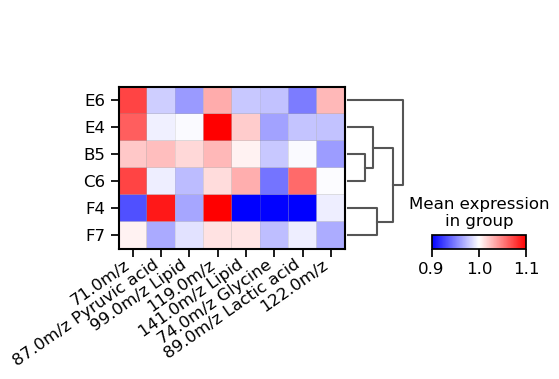

In [91]:
var = 'Tissue'
sc.tl.dendrogram(adata, groupby=var)
with sns.plotting_context('notebook', font_scale=1.2):
    ax = sc.pl.matrixplot(adata, var_names=glucose_frag, 
                     groupby=var, cmap='bwr',
                     dendrogram=True, show=False, vmax=1.1, vmin=0.9)     
    xticklabels = ax['mainplot_ax'].get_xticklabels()
    ax['mainplot_ax'].set_xticklabels(xticklabels, rotation = 35, ha="right")
    ax['mainplot_ax'].tick_params(axis='x', pad=0)
    plt.show()

# Patient level comparison

In [92]:
adata_raw.obs['Core'] = adata_raw.obs['Core'].astype('category')

         Falling back to preprocessing with `sc.pp.pca` and default params.
computing PCA
    with n_comps=50
    finished (0:00:00)
Storing dendrogram info using `.uns['dendrogram_Core']`
ranking genes


... storing 'Dataset' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


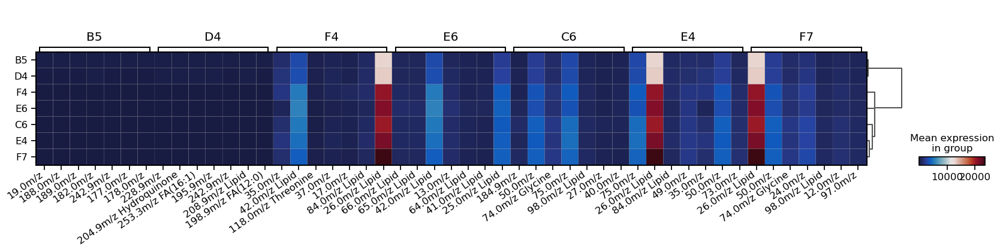

In [93]:
sc.tl.dendrogram(adata_raw, groupby='Core')
sc.tl.rank_genes_groups(adata_raw, groupby='Core', method='t-test_overestim_var')

with sns.plotting_context('notebook', font_scale=1.2):
    ax = sc.pl.rank_genes_groups_matrixplot(adata_raw, n_genes=7, use_raw=False, cmap=heatmap_cmp, show=False)
    xticklabels = ax['mainplot_ax'].get_xticklabels()
    ax['mainplot_ax'].set_xticklabels(xticklabels, rotation = 35, ha="right")
    ax['mainplot_ax'].tick_params(axis='x', pad=0)
    plt.show()

In [94]:
# Extract diff expression dataframe
dedf = sc.get.rank_genes_groups_df(adata_raw, group=None)

# Get top diff expression
topk=2
masses_largest = dedf.groupby('group').apply(lambda x: x.nlargest(topk,['scores'])).names.unique()
masses_lowest = dedf.groupby('group').apply(lambda x: x.nsmallest(topk,['scores'])).names.unique()
# masses = np.unique(np.concatenate([masses_largest, masses_lowest]))
masses = masses_largest

In [95]:
var = 'Core'

# Get subset of masses
adata_subset = adata_raw[:,masses]

# Get dataframe
df_SIMS = pd.DataFrame(adata_subset.X, columns=adata_subset.var_names)
df_SIMS[var] = adata_subset.obs[var].tolist()
# df_SIMS.drop(['1.0'], axis=1, inplace=True)

# Sort masses by GC eexpression
df_SIMS_var = (df_SIMS
                .melt(id_vars=var, var_name='mz', value_name='Normalized ion count'))
df = df_SIMS_var[df_SIMS_var[var] == 'F7'].groupby('mz').mean()
df.sort_values('Normalized ion count', inplace=True)
masses_sorted = df.index.tolist()

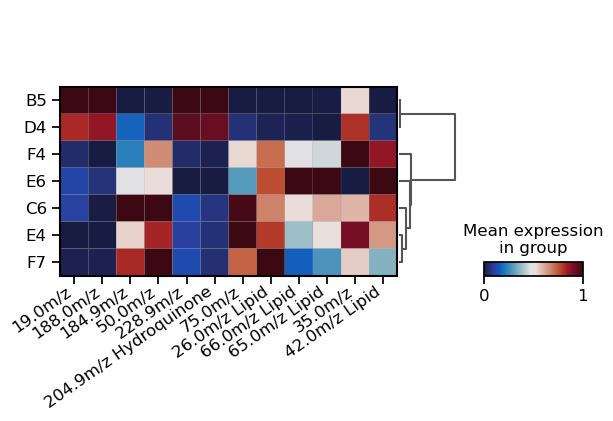

In [96]:
with sns.plotting_context('notebook', font_scale=1.2):
    ax = sc.pl.matrixplot(adata_subset, var_names=masses, groupby='Core',
                    cmap=heatmap_cmp, dendrogram=True, show=False, standard_scale='var')
    xticklabels = ax['mainplot_ax'].get_xticklabels()
    ax['mainplot_ax'].set_xticklabels(xticklabels, rotation = 35, ha="right")
    ax['mainplot_ax'].tick_params(axis='x', pad=0)
    plt.show()